In [ ]:
# import modules
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
from time import time

In [104]:
# spend time
start_time = time()

In [105]:
# functions
def check_path(path):
    """
    Check if a path exists, if not create it.
    """
    os.makedirs(path, exist_ok=True)

In [106]:
# load data
data = pd.read_csv('Math-Students.csv')
print(f'Data:\n{data}')

Data:
    school sex  age address famsize Pstatus  Medu  Fedu     Mjob      Fjob  \
0       GP   F   18       U     GT3       A     4     4  at_home   teacher   
1       GP   F   17       U     GT3       T     1     1  at_home     other   
2       GP   F   15       U     LE3       T     1     1  at_home     other   
3       GP   F   15       U     GT3       T     4     2   health  services   
4       GP   F   16       U     GT3       T     3     3    other     other   
..     ...  ..  ...     ...     ...     ...   ...   ...      ...       ...   
394     MS   M   19       U     LE3       T     1     1    other   at_home   
395     MS   M   18       U     GT3       T     4     4  teacher  services   
396     MS   M   17       U     GT3       T     4     4  teacher  services   
397     MS   M   19       U     GT3       T     4     4  teacher     other   
398     MS   M   18       U     GT3       T     4     4  teacher   at_home   

     ... famrel freetime  goout  Dalc  Walc health absenc

In [107]:
# remove the rows with NAs
NAs = data.isna().sum()
print(f'NAs:\n{NAs} \nTotal NAs: {NAs.sum()}')

data = data.dropna(axis=0, how='any')
print(f'After removing NAs, data shape: {data.shape}')

NAs:
school        0
sex           0
age           0
address       0
famsize       0
Pstatus       0
Medu          0
Fedu          0
Mjob          0
Fjob          0
reason        0
guardian      0
traveltime    0
studytime     0
failures      0
schoolsup     0
famsup        0
paid          0
activities    0
nursery       0
higher        0
internet      0
romantic      0
famrel        0
freetime      0
goout         0
Dalc          0
Walc          0
health        0
absences      0
G1            0
G2            0
G3            0
dtype: int64 
Total NAs: 0
After removing NAs, data shape: (399, 33)


In [108]:
# data summary
print(f'Data shape: {data.shape}')

print(f'Null count & Data type:')
print(data.info())

print(f'Data summary:\n{data.describe()}')

categoricals = {
    col: data[col].value_counts() for col in data.select_dtypes(include='object').columns
}
print("Categoricals:\n", pd.DataFrame({k: pd.Series([f"{idx} ({val})" for idx, val in v.items()]) for k, v in categoricals.items()}).fillna('').to_string(index=False))

print(f'Duplicates: {data.duplicated().sum()}')

data_original = data.copy()

Data shape: (399, 33)
Null count & Data type:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 399 entries, 0 to 398
Data columns (total 33 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   school      399 non-null    object
 1   sex         399 non-null    object
 2   age         399 non-null    int64 
 3   address     399 non-null    object
 4   famsize     399 non-null    object
 5   Pstatus     399 non-null    object
 6   Medu        399 non-null    int64 
 7   Fedu        399 non-null    int64 
 8   Mjob        399 non-null    object
 9   Fjob        399 non-null    object
 10  reason      399 non-null    object
 11  guardian    399 non-null    object
 12  traveltime  399 non-null    int64 
 13  studytime   399 non-null    int64 
 14  failures    399 non-null    int64 
 15  schoolsup   399 non-null    object
 16  famsup      399 non-null    object
 17  paid        399 non-null    object
 18  activities  399 non-null    object
 19  nurs

In [ ]:
# config

## class
feature_class = {
    'support': ['schoolsup', 'famsup', 'paid'],
    'family': ['address', 'famsize', 'Pstatus', 'guardian', 'traveltime', 'famrel'],
    'parents': ['Medu', 'Fedu', 'Mjob', 'Fjob'],
    'performance': ['failures', 'studytime', 'absences'],
    'alcohol': ['Dalc', 'Walc', 'health'],
    'after_class': ['activities', 'freetime', 'goout'],
    'school_choice': ['reason', 'nursery', 'higher']
}

special_class = {
    'score': ['G1', 'G2', 'G3']
}

## factor
factors = {
    'schoolsup': ['no', 'yes'],
    'famsup': ['no', 'yes'],
    'paid': ['no', 'yes'],
    'activities': ['no', 'yes'],
    'nursery': ['no', 'yes'],
    'higher': ['no', 'yes'],
    'internet': ['no', 'yes'],
    'romantic': ['no', 'yes']
}

## one-hot encoding
one_hot_encoding = {
    'school': ['GP', 'MS'],
    'sex': ['F', 'M'],
    'address': ['U', 'R'],
    'famsize': ['GT3', 'LE3'],
    'Pstatus': ['T', 'A'],
    'Mjob': ['other', 'at_home', 'health', 'services', 'teacher'],
    'Fjob': ['other', 'at_home', 'health', 'services', 'teacher'],
    'reason': ['other', 'home', 'course', 'reputation'],
    'guardian': ['other', 'mother', 'father']
}

## prediction label
Y_label = 'G3'

In [110]:
# correlation by classes
_object = {k: v for k, v in {**factors, **one_hot_encoding}.items() if k in sum(feature_class.values(), [])}


for group_name, columns in _object.items():
    data[group_name] = pd.Categorical(data[group_name], categories=columns, ordered=True).codes

In [111]:
data = data.loc[(data_original['school'] == 'GP'), :]
data.drop(columns=['G1', 'G2', 'school'], inplace=True)
data.shape

(349, 30)

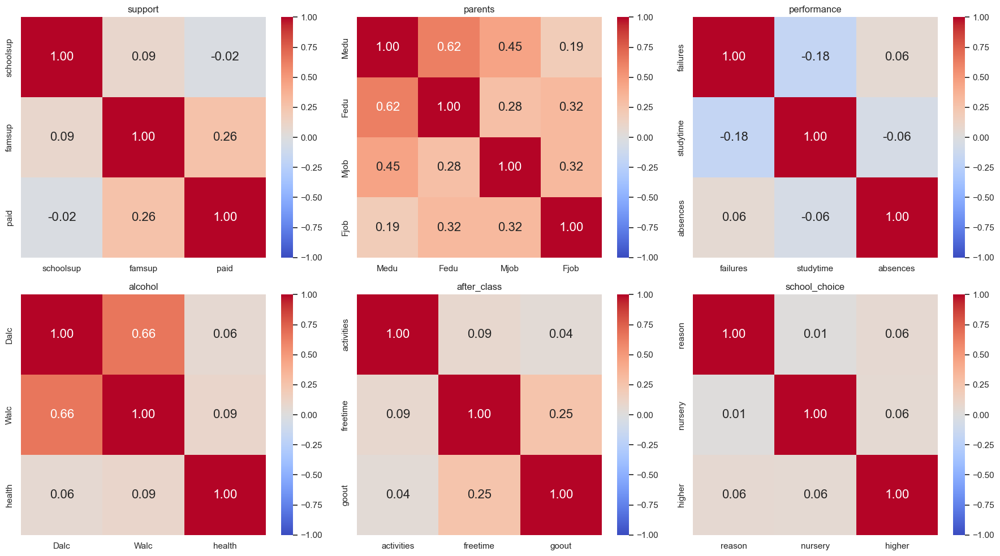

In [112]:
# correlation plot of each plot but just on an image
fig, axes = plt.subplots(2, 3, figsize=(18, 10))  # 2 rows, 3 columns
axes = axes.flatten() 

plot_index = 0
for group_name, columns in feature_class.items():
    if group_name == 'family':
        continue
    cor_matrix = data[columns].corr()

    sns.heatmap(cor_matrix, ax=axes[plot_index], cmap='coolwarm', vmin=-1, vmax=1, annot=True, fmt=".2f", annot_kws={'fontsize': 16})
    axes[plot_index].set_title(group_name)
    plot_index += 1

    if plot_index >= 6:
        break

plt.tight_layout()
path = 'correlation matrix\\class'
check_path(path)
plt.savefig(f'{path}\\correlation matrix all groups.png')
plt.show()

C:\Users\user\AppData\Local\Temp\ipykernel_13584\2430370013.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



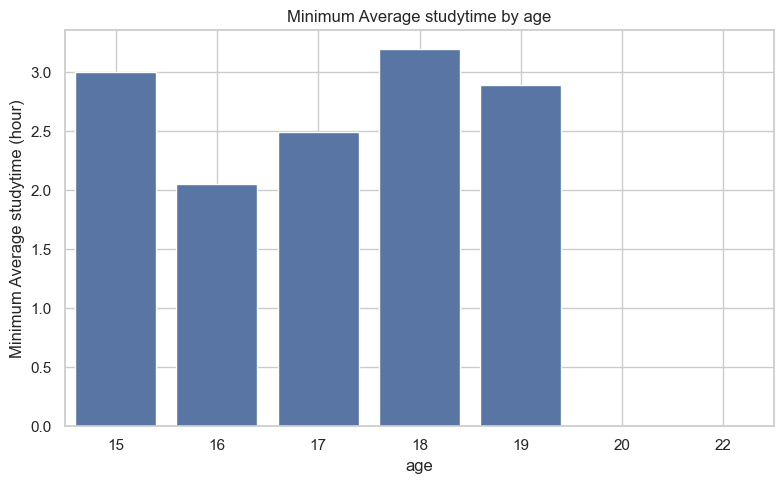

In [76]:
# age vs. studytime
age_studytime = data[['age', 'studytime']]
age_studytime['studytime'] = age_studytime['studytime'].map({1: 0, 2: 2, 3: 5, 4: 10})
age_studytime = age_studytime.groupby('age', as_index=False)['studytime'].mean()

plt.figure(figsize=(8, 5))
sns.barplot(data=age_studytime, x='age', y='studytime')

plt.xlabel('age')
plt.ylabel('Minimum Average studytime (hour)')
plt.title('Minimum Average studytime by age')
plt.tight_layout()
plt.grid(True)
path = 'bar plot'
check_path(path)
plt.savefig(f'{path}\\Average Study Time by Age.png')
plt.show()

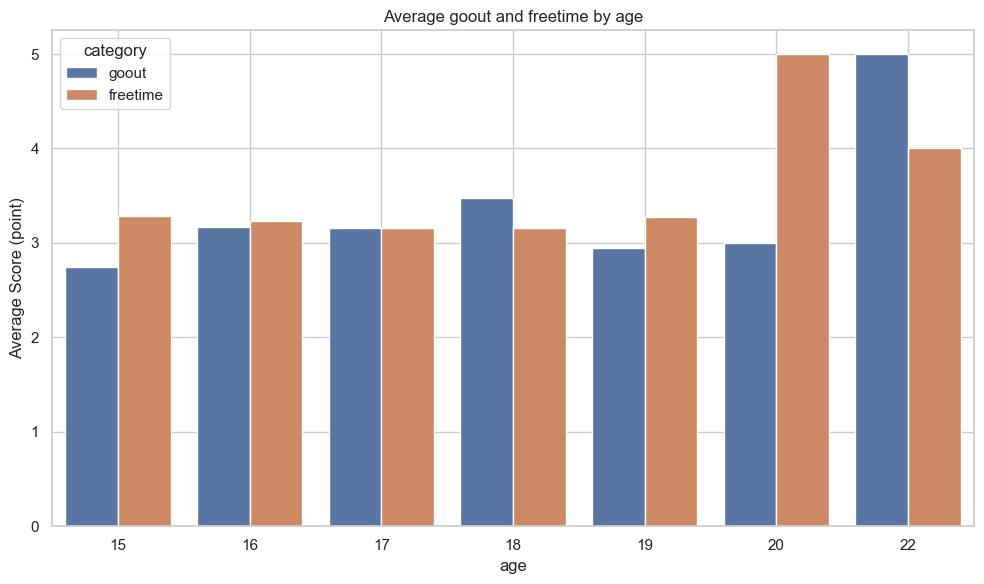

In [77]:
# age vs. goout and freetime
age_goout_freetime = data.groupby('age', as_index=False)[['goout', 'freetime']].mean().melt(id_vars='age', value_vars=['goout', 'freetime'], var_name='category', value_name='average')

plt.figure(figsize=(10, 6))
sns.barplot(data=age_goout_freetime, x='age', y='average', hue='category')

plt.xlabel('age')
plt.ylabel('Average Score (point)')
plt.title('Average goout and freetime by age')
plt.tight_layout()
plt.grid(True)
path = 'bar plot'
check_path(path)
plt.savefig(f'{path}\\Average Go Out and Freetime by Age.png')
plt.show()

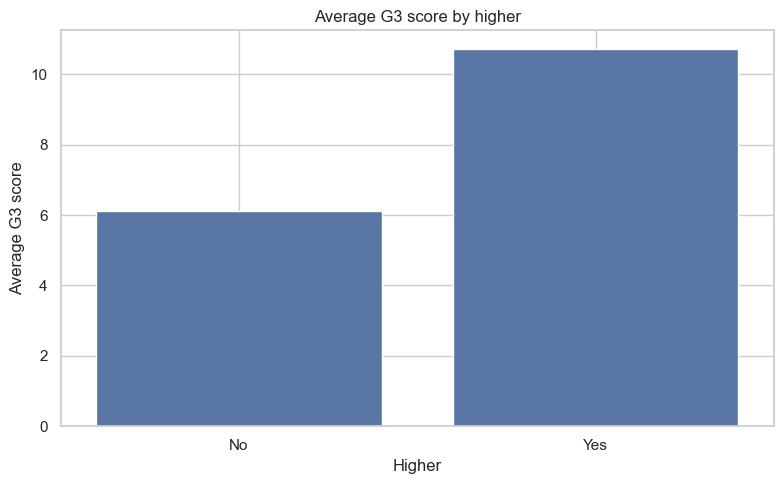

In [78]:
# higher vs. G3
higher_G3 = data.groupby('higher', as_index=False)['G3'].mean()
higher_G3['higher'] = higher_G3['higher'].map({0: 'No', 1: 'Yes'})

plt.figure(figsize=(8, 5))
sns.barplot(data=higher_G3, x='higher', y='G3')

plt.xlabel('Higher')
plt.ylabel('Average G3 score')
plt.title('Average G3 score by higher')
plt.tight_layout()
plt.grid(True)
path = 'bar plot'
check_path(path)
plt.savefig(f'{path}\\Average G3 score by higher.png')
plt.show()

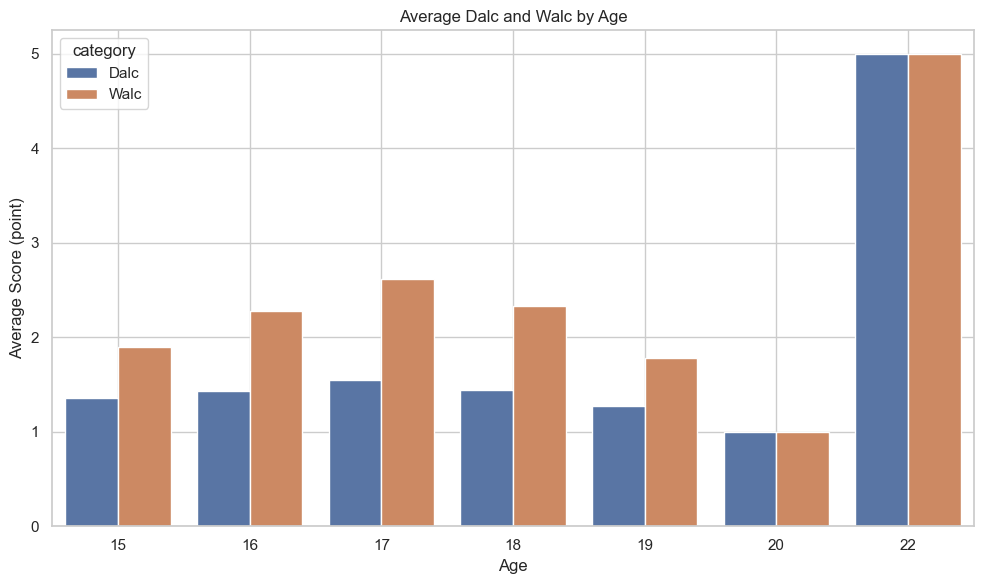

In [79]:
 # Dalc and Walc vs. health
alc_health = data.groupby('age', as_index=False)[['Dalc', 'Walc']].mean().melt(id_vars='age', value_vars=['Dalc', 'Walc'], var_name='category', value_name='average')

plt.figure(figsize=(10, 6))
sns.barplot(data=alc_health, x='age', y='average', hue='category')

plt.xlabel('Age')
plt.ylabel('Average Score (point)')
plt.title('Average Dalc and Walc by Age')
plt.grid(True)
plt.tight_layout()
path = 'bar plot'
check_path(path)
plt.savefig(f'{path}\\Average Dalc and Walc by Age.png')
plt.show()

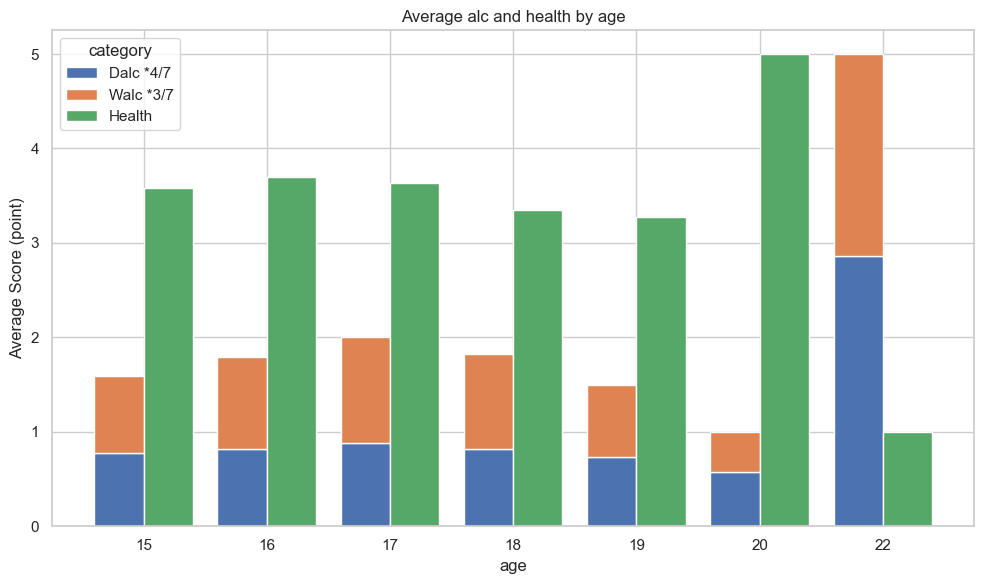

In [80]:
agg = (data.groupby('age', as_index=False)[['Dalc', 'Walc', 'health']].mean())
agg['Dalc_w'] = agg['Dalc'] * (4/7)
agg['Walc_w'] = agg['Walc'] * (3/7)
agg['Health'] = agg['health']

sns.set_theme(style="whitegrid")

ages = agg['age'].astype(int).values
x    = np.arange(len(ages))
bar_w = 0.4
palette = sns.color_palette()

plt.figure(figsize=(10, 6))

plt.bar(
    x - bar_w/2,
    agg['Dalc_w'],
    width=bar_w,
    color=palette[0],
    label='Dalc *4/7'
)
plt.bar(
    x - bar_w/2,
    agg['Walc_w'],
    width=bar_w,
    bottom=agg['Dalc_w'],
    color=palette[1],
    label='Walc *3/7'
)

plt.bar(
    x + bar_w/2,
    agg['Health'],
    width=bar_w,
    color=palette[2],
    label='Health'
)

plt.grid(False)
plt.xlabel('age')
plt.ylabel('Average Score (point)')
plt.xticks(x, ages)
plt.title('Average alc and health by age')
plt.grid(True)
plt.legend(title='category', frameon=True)
plt.tight_layout()
path = 'bar plot'
check_path(path)
plt.savefig(f'{path}\\Average alc and Health by Age.png')
plt.show()

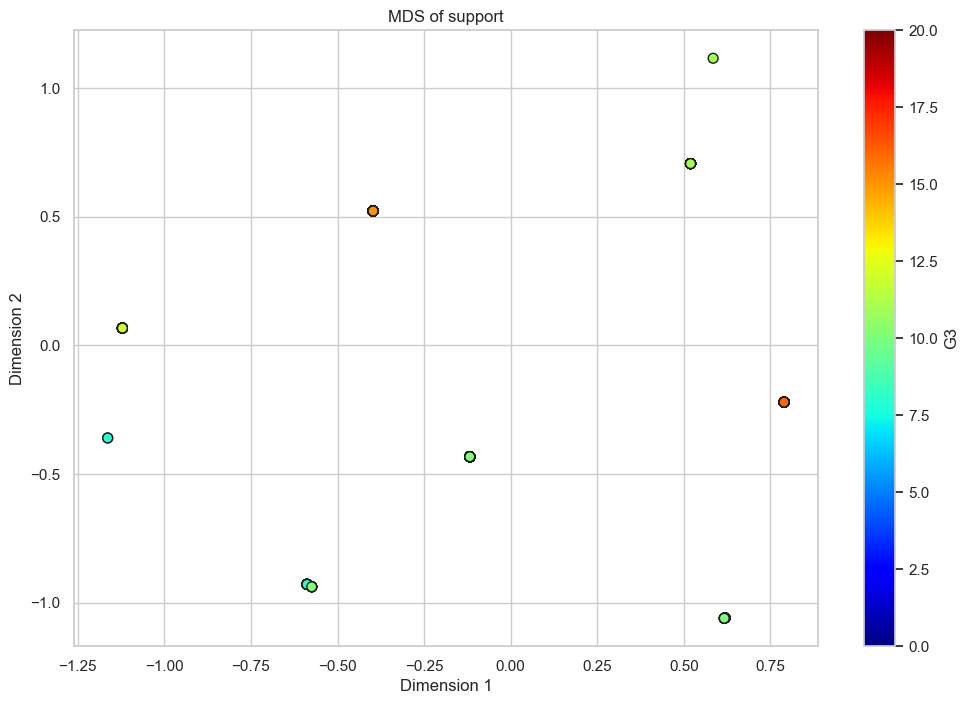

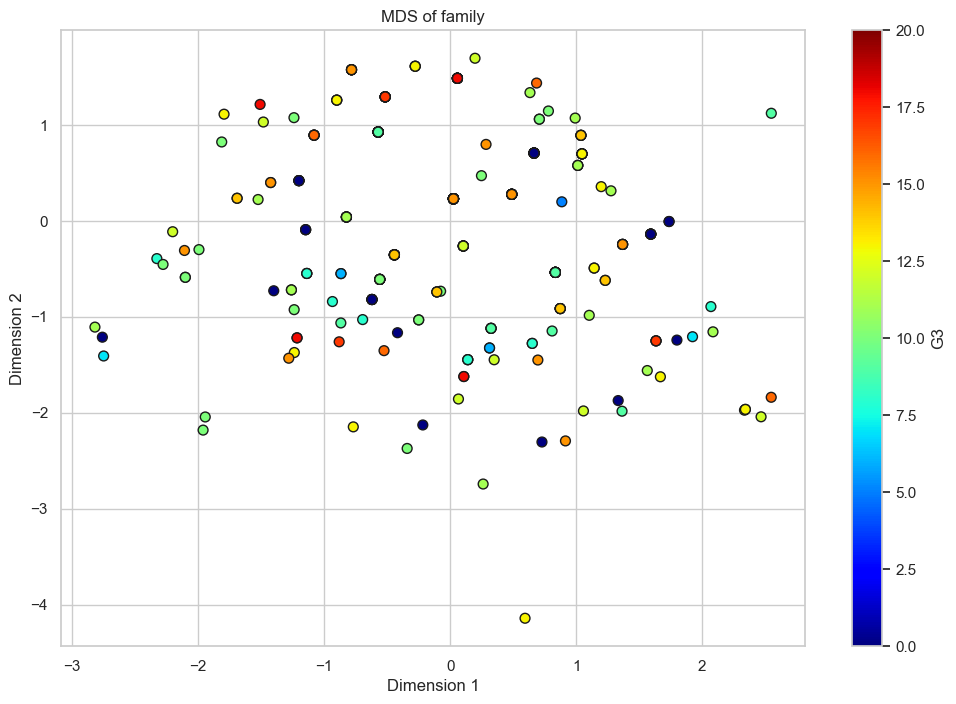

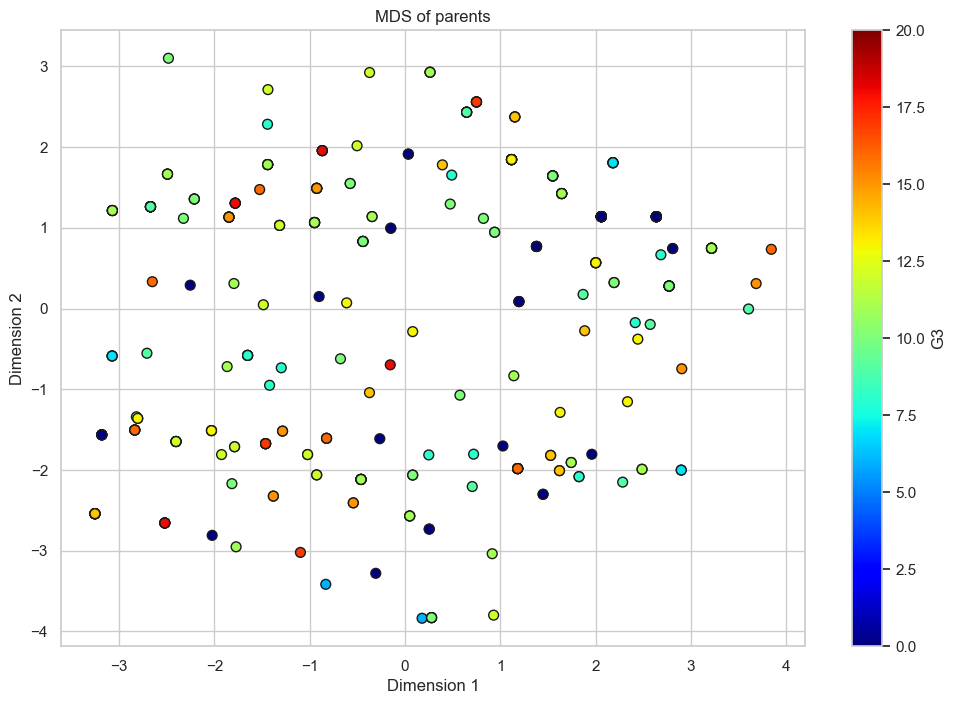

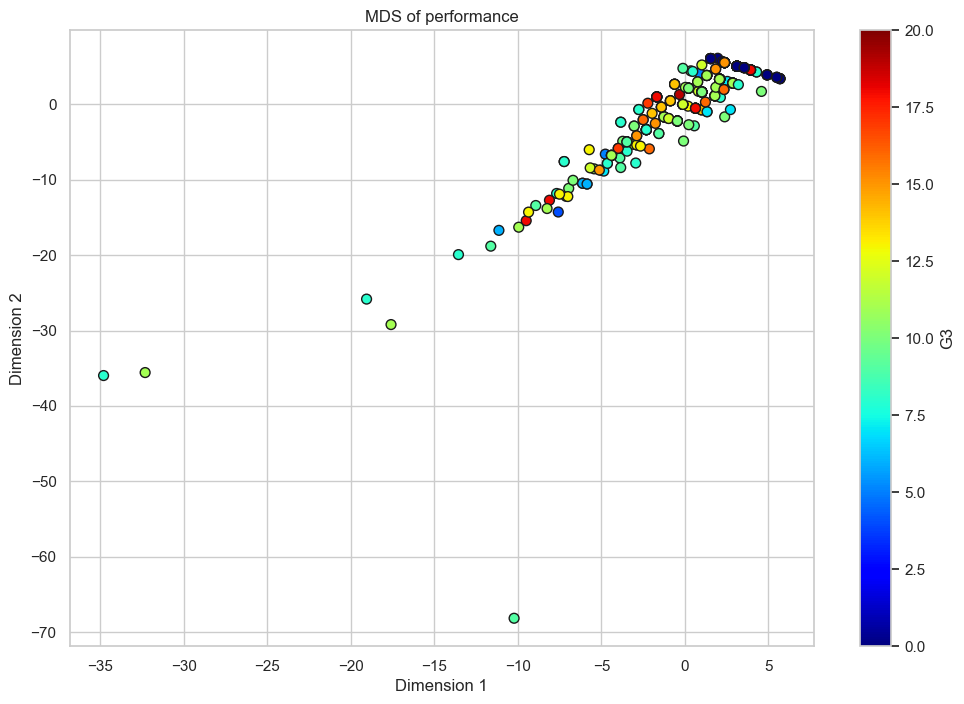

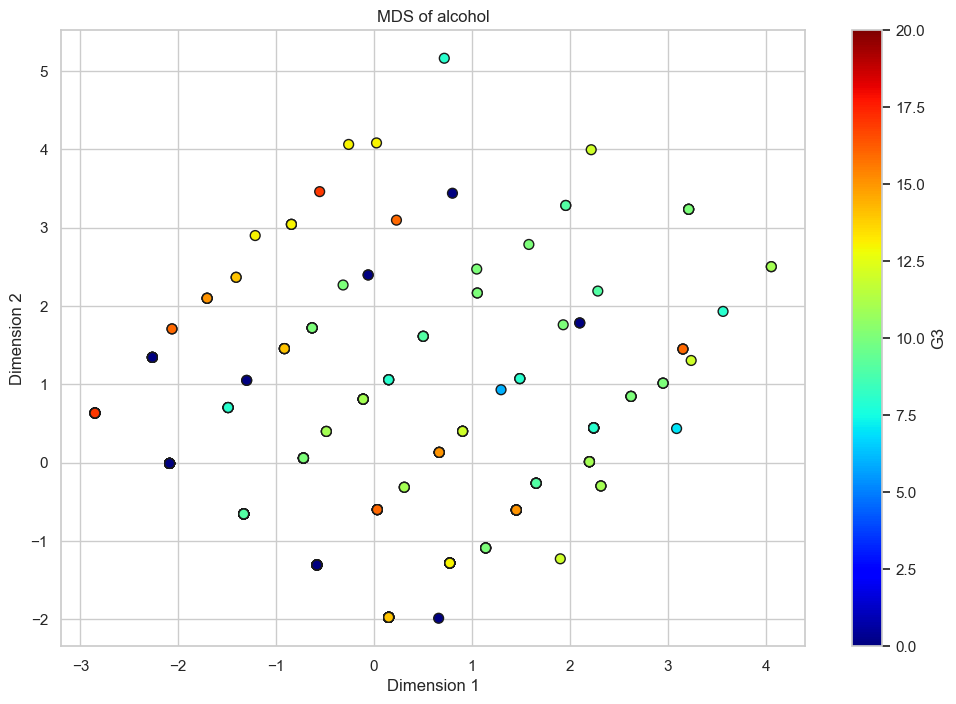

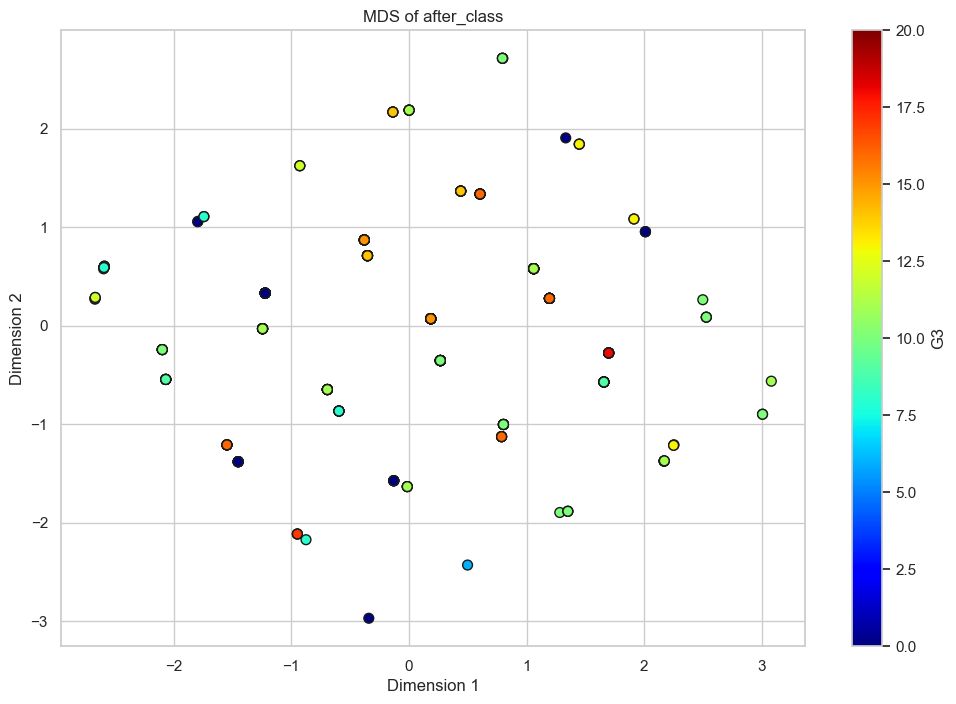

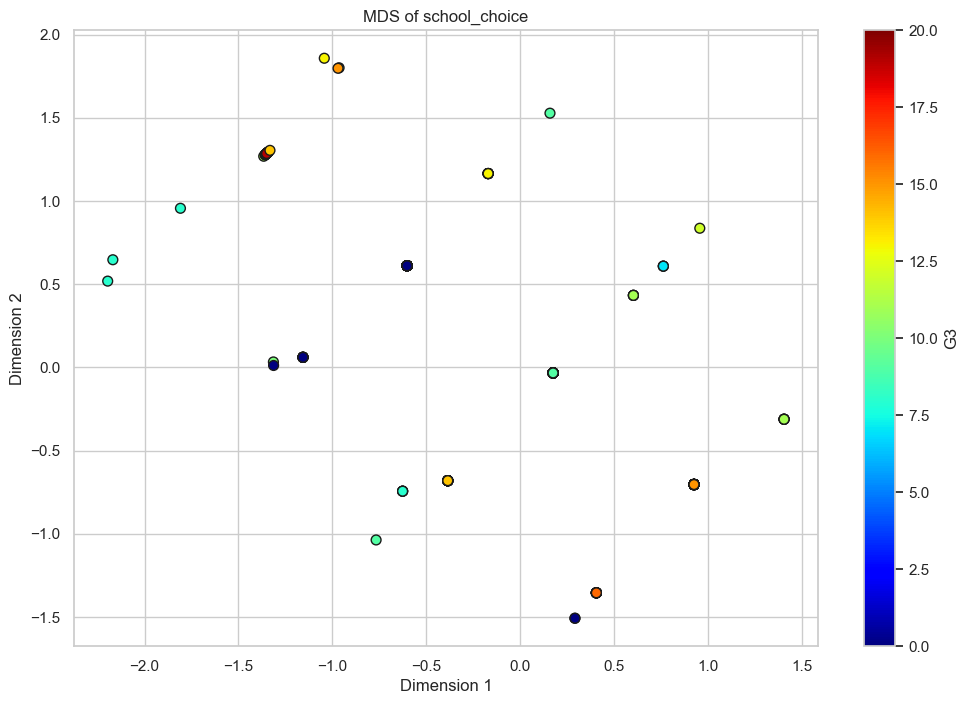

In [81]:
from sklearn.metrics import pairwise_distances
from sklearn.manifold import MDS

for group_name, columns in feature_class.items():
    # correlation matrix by plotly for each group
    cor_matrix = data[columns].corr()
    cor_matrix_rounded = cor_matrix.round(1)

    fig = px.imshow(cor_matrix_rounded, 
                    title=f'Correlation Matrix of {group_name} datas',
                    color_continuous_scale='RdBu_r',
                    text_auto=True,
                    zmin=-1, zmax=1
    )

    fig.update_traces(
        hovertemplate='Variable: %{x}<br>Variable: %{y}<br>Correlation: %{customdata}', 
        customdata=cor_matrix.values.tolist()
    )

    fig.update_layout(
        width=500,
        height=500, 
        xaxis=dict(tickmode='array', tickvals=list(range(len(cor_matrix.columns))), ticktext=cor_matrix.columns),
        yaxis=dict(tickmode='array', tickvals=list(range(len(cor_matrix.index))), ticktext=cor_matrix.index),
        margin=dict(b=200)
    )

    path = 'correlation matrix\\class'
    check_path(path)
    fig.write_html(f'{path}\\correlation matrix.html')
    fig.show()

    # group euclidean distances
    data_class_distance = pairwise_distances(data[columns], metric='euclidean')
    fig = px.imshow(data_class_distance, 
                    title=f'Euclidean Distances of {group_name} datas',
                    color_continuous_scale='RdBu_r',
                    text_auto=True
    )

    fig.update_layout(
        width=800,
        height=800
    )

    fig.update_traces(
        hovertemplate='Sample: %{x}<br>Sample: %{y}<br>Distance: %{customdata}', 
        customdata=data_class_distance.tolist()
    )

    path = 'euclidean distances\\class'
    check_path(path)
    fig.write_html(f'{path}\\{group_name}.html')
    fig.show()

    # MDS
    n_components = 2
    mds = MDS(n_components=n_components, dissimilarity='precomputed', random_state=42)  # 'precomputed' says that had compute the distances, `random_state` is the seed
    data_class_mds = mds.fit_transform(data_class_distance)

    data.drop(columns=feature_class[group_name], inplace=True)
    data[f'{group_name}_dim1'] = data_class_mds[:, 0]
    data[f'{group_name}_dim2'] = data_class_mds[:, 1]

    plt.figure(figsize=(12, 8))
    plt.title(f'MDS of {group_name}')
    plt.xlabel("Dimension 1")
    plt.ylabel("Dimension 2")
    scatter = plt.scatter(data_class_mds[:, 0], data_class_mds[:, 1], c=data[Y_label], cmap='jet', edgecolor='k', s=50)
    cbar = plt.colorbar(scatter)
    cbar.set_label(f'{Y_label}')
    plt.grid(True)
    path = 'MDS\\class'
    check_path(path)
    plt.savefig(f'{path}\\{group_name}.png')
    plt.show()

In [82]:
# special class plot
for group_name, columns in special_class.items():
    cor_matrix = data[columns].corr()
    fig, ax = plt.subplots(figsize=(4, 3.5))
    sns.heatmap(cor_matrix, ax=ax, cmap='coolwarm', vmin=-1, vmax=1, annot=True, fmt=".2f")
    ax.set_title(group_name)

    plt.tight_layout()
    path = 'correlation matrix'
    check_path(path)
    plt.savefig(f'{path}\\{group_name}.png')
    plt.show()

if special_class:
    for group_name, columns in special_class.items():
        # correlation matrix by plotly for each group
        cor_matrix = data[columns].corr()
        cor_matrix_rounded = cor_matrix.round(1)

        fig = px.imshow(cor_matrix_rounded, 
                        title=f'Correlation Matrix of {group_name} datas',
                        color_continuous_scale='RdBu_r',
                        text_auto=True,
                        zmin=-1, zmax=1
        )

        fig.update_traces(
            hovertemplate='Variable: %{x}<br>Variable: %{y}<br>Correlation: %{customdata}', 
            customdata=cor_matrix.values.tolist()
        )

        fig.update_layout(
            width=500,
            height=500, 
            xaxis=dict(tickmode='array', tickvals=list(range(len(cor_matrix.columns))), ticktext=cor_matrix.columns),
            yaxis=dict(tickmode='array', tickvals=list(range(len(cor_matrix.index))), ticktext=cor_matrix.index),
            margin=dict(b=200)
        )

        path = 'correlation matrix\\class'
        check_path(path)
        fig.write_html(f'{path}\\correlation matrix.html')
        fig.show()
        
        # group euclidean distances
        data_class_distance = pairwise_distances(data[columns], metric='euclidean')
        fig = px.imshow(data_class_distance, 
                        title=f'Euclidean Distances of {group_name} datas',
                        color_continuous_scale='RdBu_r',
                        text_auto=True
        )

        fig.update_layout(
            width=800,
            height=800
        )

        fig.update_traces(
            hovertemplate='Sample: %{x}<br>Sample: %{y}<br>Distance: %{customdata}', 
            customdata=data_class_distance.tolist()
        )

        path = 'euclidean distances\\class'
        check_path(path)
        fig.write_html(f'{path}\\{group_name}.html')
        fig.show()

        # MDS
        n_components = 2
        mds = MDS(n_components=n_components, dissimilarity='precomputed', random_state=42)  # 'precomputed' says that had compute the distances, `random_state` is the seed
        data_class_mds = mds.fit_transform(data_class_distance)
        plt.figure(figsize=(12, 8))
        plt.title(f'MDS of {group_name}')
        plt.xlabel("Dimension 1")
        plt.ylabel("Dimension 2")
        scatter = plt.scatter(data_class_mds[:, 0], data_class_mds[:, 1], c=data[Y_label], cmap='jet', edgecolor='k', s=50)
        cbar = plt.colorbar(scatter)
        cbar.set_label(f'{Y_label}')
        plt.grid(True)
        path = 'MDS\\class'
        check_path(path)
        plt.savefig(f'{path}\\{group_name}.png')
        plt.show()

KeyError: "['G1', 'G2'] not in index"

In [83]:
data.columns

Index(['sex', 'age', 'internet', 'romantic', 'G3', 'support_dim1',
       'support_dim2', 'family_dim1', 'family_dim2', 'parents_dim1',
       'parents_dim2', 'performance_dim1', 'performance_dim2', 'alcohol_dim1',
       'alcohol_dim2', 'after_class_dim1', 'after_class_dim2',
       'school_choice_dim1', 'school_choice_dim2'],
      dtype='object')

In [86]:
# factor
for k, v in factors.items():
    try:
        data[k + '_factor'] = pd.Categorical(data[k], categories=v, ordered=True).codes  ## assign the factor codes
    except:
        print(f'Cannot modify {k} to factor.')
        continue

# one-hot encoding
for k, v in one_hot_encoding.items():
    try:
        data = pd.get_dummies(data, columns=[k], prefix=k)
    except:
        print(f'Cannot modify {k} to one-hot encoding.')
        continue

# save to df
df = data.copy()
df = df.drop(columns=[k for k, v in factors.items()], errors='ignore')
for k, v in factors.items():
    df = df.rename(columns={k + '_factor': k}, errors='ignore')

# show df
print(f'DataFrame sorted:\n{df}')

Cannot modify schoolsup to factor.
Cannot modify famsup to factor.
Cannot modify paid to factor.
Cannot modify activities to factor.
Cannot modify nursery to factor.
Cannot modify higher to factor.
Cannot modify school to one-hot encoding.
Cannot modify sex to one-hot encoding.
Cannot modify address to one-hot encoding.
Cannot modify famsize to one-hot encoding.
Cannot modify Pstatus to one-hot encoding.
Cannot modify Mjob to one-hot encoding.
Cannot modify Fjob to one-hot encoding.
Cannot modify reason to one-hot encoding.
Cannot modify guardian to one-hot encoding.
DataFrame sorted:
     age  G3  support_dim1  support_dim2  family_dim1  family_dim2  \
0     18   6      0.619583     -1.059479    -0.866216    -0.548798   
1     17   6     -0.117928     -0.433044     0.057769     1.488577   
2     15  10     -1.163662     -0.360010     0.489198     0.277903   
3     15  15     -0.397364      0.522665     0.834604    -0.536265   
4     16  10     -0.397364      0.522665     0.665526     

In [87]:
# drop school
df = df[~df['school_MS']]
df.drop(columns=['school_MS', 'school_GP'], inplace=True)
print(f'df:\n{df}')

KeyError: 'school_MS'

In [ ]:
print(f'Columns:\n{data.columns.values}')
print(f'Number of features: {len(data.columns)}')

Columns:
['age' 'internet' 'romantic' 'G1' 'G2' 'G3' 'support_dim1' 'support_dim2'
 'family_dim1' 'family_dim2' 'parents_dim1' 'parents_dim2'
 'performance_dim1' 'performance_dim2' 'alcohol_dim1' 'alcohol_dim2'
 'after_class_dim1' 'after_class_dim2' 'school_choice_dim1'
 'school_choice_dim2' 'internet_factor' 'romantic_factor' 'school_GP'
 'school_MS' 'sex_F' 'sex_M']
Number of features: 26


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 349 entries, 0 to 348
Data columns (total 22 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   age                 349 non-null    int64  
 1   G1                  349 non-null    int64  
 2   G2                  349 non-null    int64  
 3   G3                  349 non-null    int64  
 4   support_dim1        349 non-null    float64
 5   support_dim2        349 non-null    float64
 6   family_dim1         349 non-null    float64
 7   family_dim2         349 non-null    float64
 8   parents_dim1        349 non-null    float64
 9   parents_dim2        349 non-null    float64
 10  performance_dim1    349 non-null    float64
 11  performance_dim2    349 non-null    float64
 12  alcohol_dim1        349 non-null    float64
 13  alcohol_dim2        349 non-null    float64
 14  after_class_dim1    349 non-null    float64
 15  after_class_dim2    349 non-null    float64
 16  school_choice

In [ ]:
# correlation matrix by plotly
cor_matrix = df.corr()
cor_matrix_rounded = cor_matrix.round(1)

fig = px.imshow(cor_matrix_rounded, 
                title="Correlation Matrix",
                color_continuous_scale='RdBu_r',
                text_auto=True,
                zmin=-1, zmax=1
)

fig.update_traces(
    hovertemplate='Variable: %{x}<br>Variable: %{y}<br>Correlation: %{customdata}', 
    customdata=cor_matrix.values.tolist()
)

fig.update_layout(
    width=1000,
    height=1000, 
    xaxis=dict(tickmode='array', tickvals=list(range(len(cor_matrix.columns))), ticktext=cor_matrix.columns),
    yaxis=dict(tickmode='array', tickvals=list(range(len(cor_matrix.index))), ticktext=cor_matrix.index),
    margin=dict(b=200)
)

path = 'correlation matrix'
check_path(path)
fig.write_html(f'{path}\\correlation matrix.html')
fig.show()

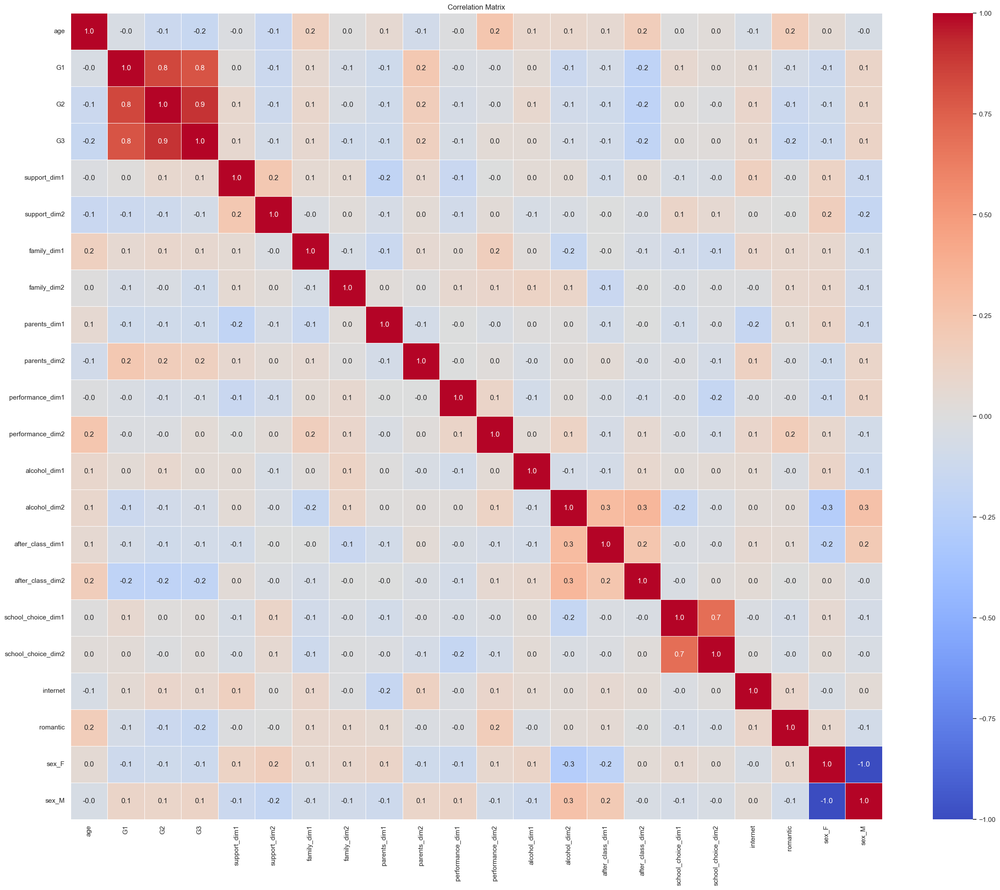

In [ ]:
# correlation matrix by seaborn
plt.figure(figsize=(30, 24))
sns.heatmap(cor_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1, linewidths=0.5, fmt='.1f')
plt.title('Correlation Matrix')
path = 'correlation matrix'
check_path(path)
plt.savefig(f'{path}\\correlation matrix.png')
plt.show()

<Figure size 1000x800 with 0 Axes>

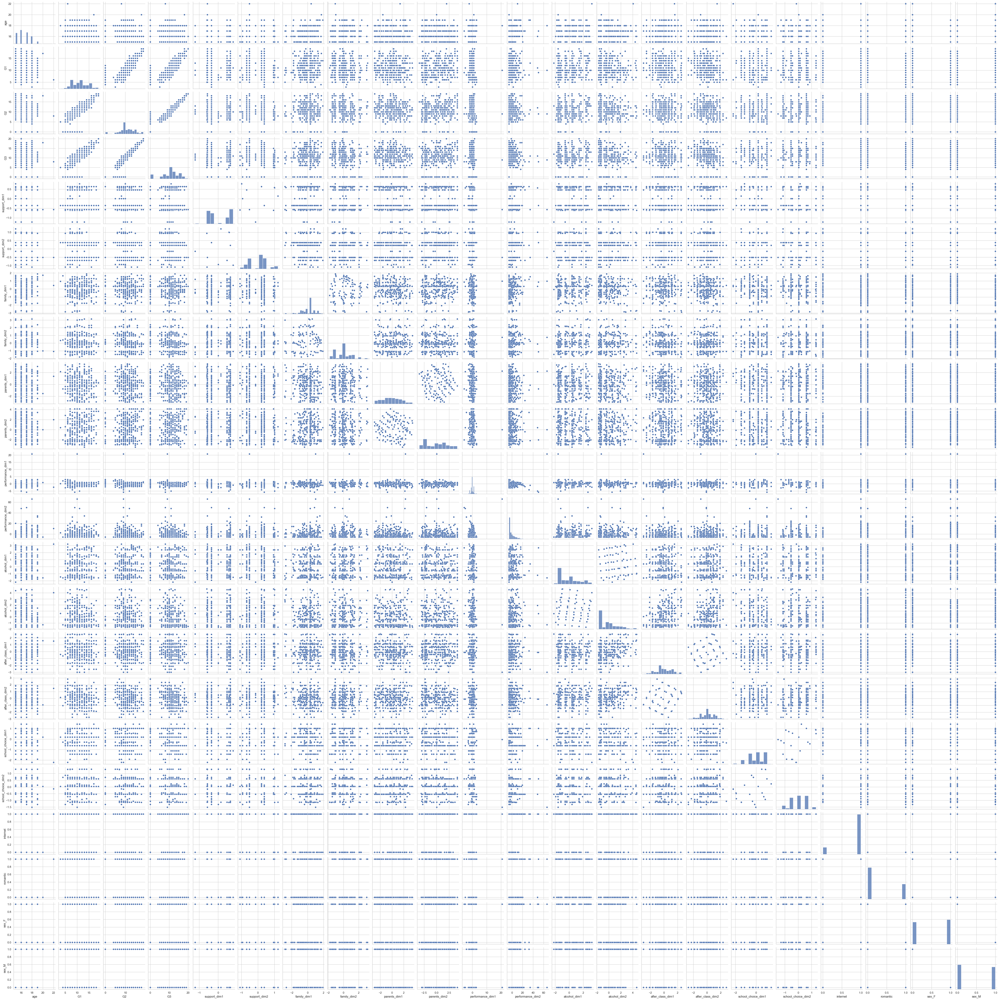

In [ ]:
# pairplot
plt.figure(figsize=(10, 8))
sns.pairplot(df)
path = 'pairs plot'
check_path(path)
plt.savefig(f'{path}\\pairs plot.png')
plt.show()

<Figure size 1000x800 with 0 Axes>

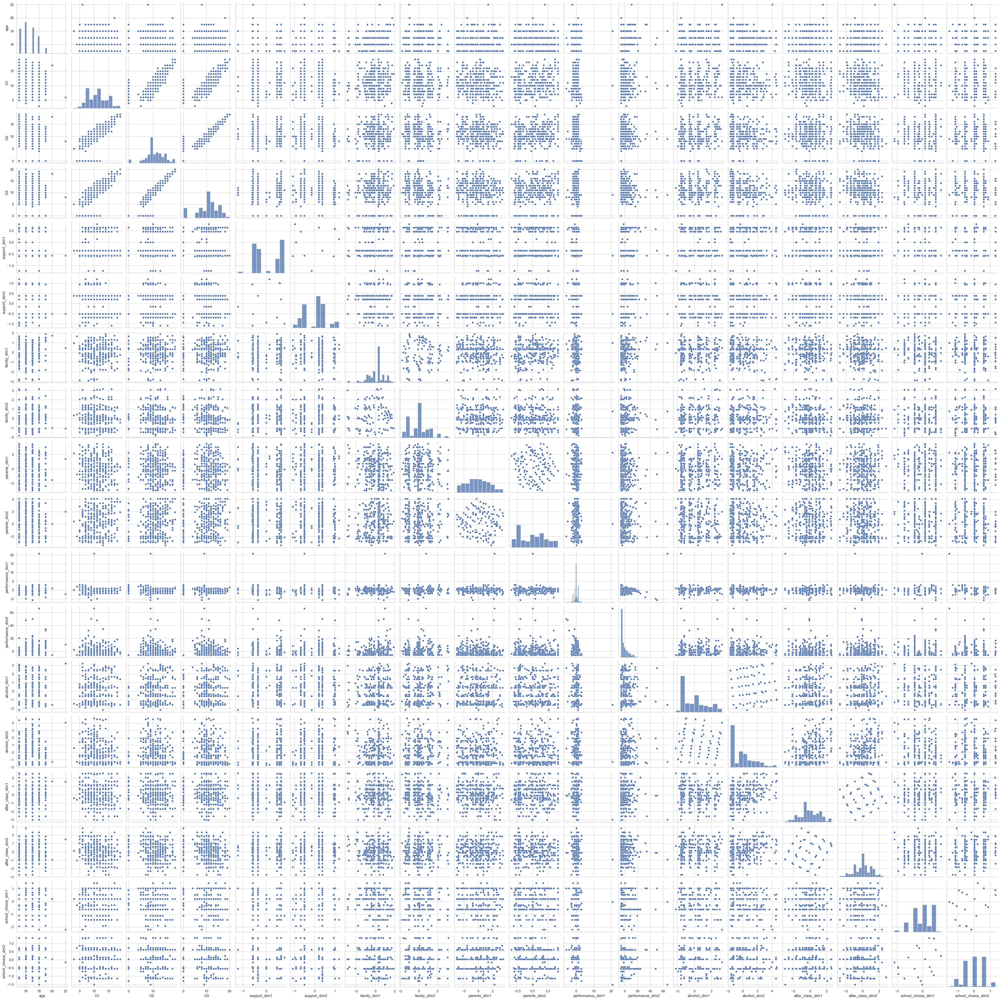

In [ ]:
# pairplot (just for the numeric columns)
plt.figure(figsize=(10, 8))
sns.pairplot(df.select_dtypes(include=['int', 'float']))
path = 'pairs plot'
check_path(path)
plt.savefig(f'{path}\\pairs plot numeric version.png')
plt.show()

<Figure size 1000x800 with 0 Axes>

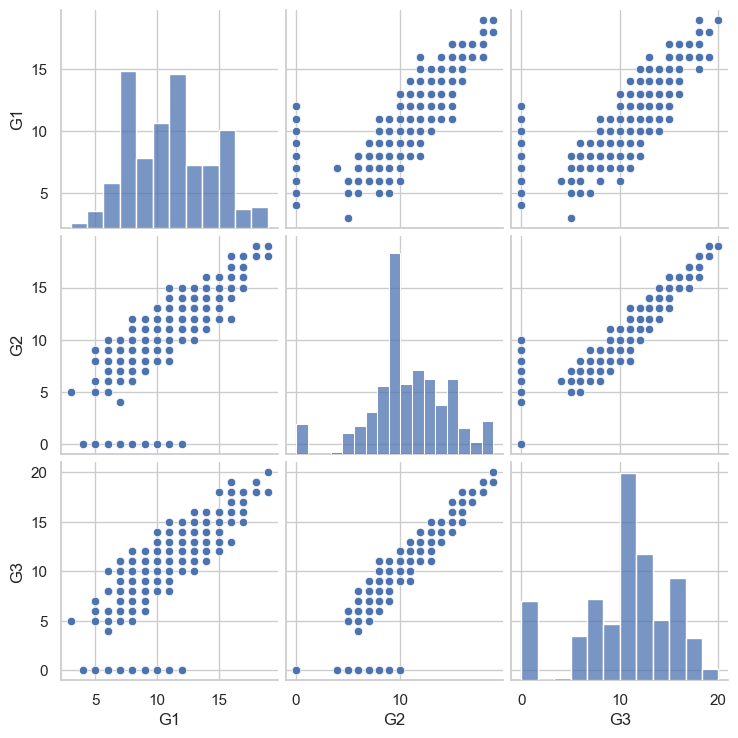

In [ ]:
# pairplot (just for G1 G2 G3)
plt.figure(figsize=(10, 8))
sns.pairplot(df[['G1', 'G2', 'G3']])
path = 'pairs plot'
check_path(path)
plt.savefig(f'{path}\\pairs plot G1 G2 G3.png')
plt.show()

In [ ]:
# scatter plot
fig = px.scatter(
    x=df['G3'],
    y=df['G2'],
    labels={
        'x': 'G3',
        'y': 'G2'
    },
    width=800,
    height=600,
    title='G3 vs. G2'
)

path = 'scatter plot'
check_path(path)
fig.write_html(f'{path}\\G3_vs_G2.html')
fig.show()

In [ ]:
# scatter plot 3d
fig = px.scatter_3d(
    df,
    x='G1',
    y='G2',
    z='G3',
    labels={'x': 'G1', 'y': 'G2', 'z': 'G3'},
    title='G1 vs. G2 vs. G3',
    width=800,
    height=800
)

fig.update_traces(
    marker=dict(
        size=3  # 點的大小
    )
)

fig.update_layout(
    scene=dict(
        aspectmode='cube'
    )
)

path = 'scatter plot'
check_path(path)
fig.write_html(f'{path}\\G1_G2_G3.html')
fig.show()

In [ ]:
df.columns

Index(['age', 'G1', 'G2', 'G3', 'support_dim1', 'support_dim2', 'family_dim1',
       'family_dim2', 'parents_dim1', 'parents_dim2', 'performance_dim1',
       'performance_dim2', 'alcohol_dim1', 'alcohol_dim2', 'after_class_dim1',
       'after_class_dim2', 'school_choice_dim1', 'school_choice_dim2',
       'internet', 'romantic', 'sex_F', 'sex_M'],
      dtype='object')

In [ ]:
path = 'scatter plot'
check_path(path)

# for i in range(len(df.columns)):
#     for j in range(len(df.columns)):
#         x_col = df.columns[i]
#         y_col = df.columns[j]
#         plt.figure(figsize=(6, 4))
#         plt.scatter(df[x_col], df[y_col], alpha=0.7)
#         plt.xlabel(x_col)
#         plt.ylabel(y_col)
#         plt.title(f"fontdict={x_col.replace('_', ' ')} vs. {y_col.replace('_', ' ')}")
#         plt.grid(True)
#         plt.savefig(f'{path}\\{x_col}_vs_{y_col}.png')
#         plt.show()

In [ ]:
data_original.columns

Index(['school', 'sex', 'age', 'address', 'famsize', 'Pstatus', 'Medu', 'Fedu',
       'Mjob', 'Fjob', 'reason', 'guardian', 'traveltime', 'studytime',
       'failures', 'schoolsup', 'famsup', 'paid', 'activities', 'nursery',
       'higher', 'internet', 'romantic', 'famrel', 'freetime', 'goout', 'Dalc',
       'Walc', 'health', 'absences', 'G1', 'G2', 'G3'],
      dtype='object')

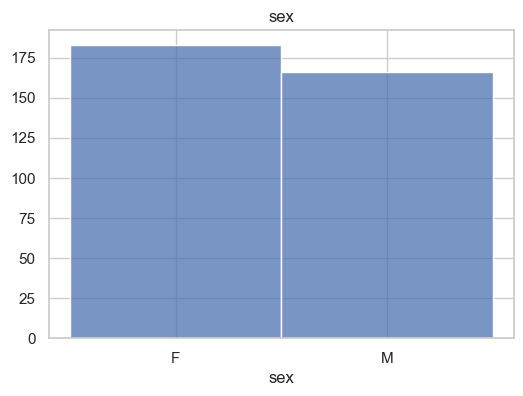

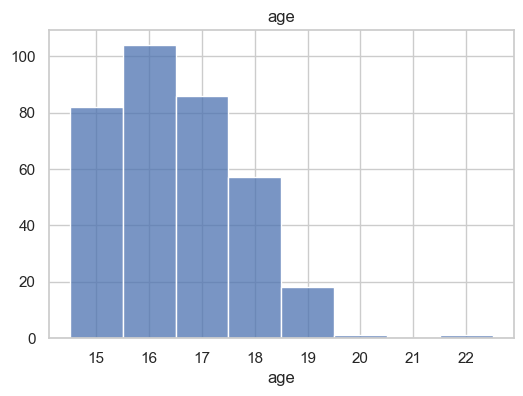

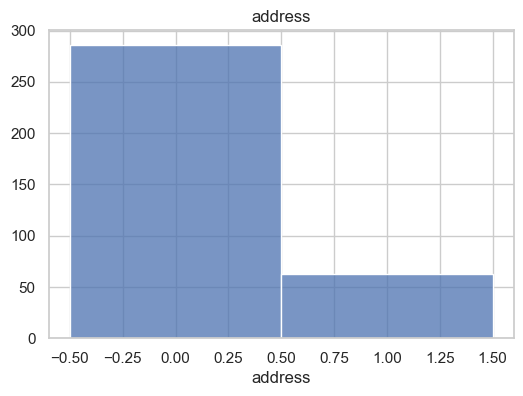

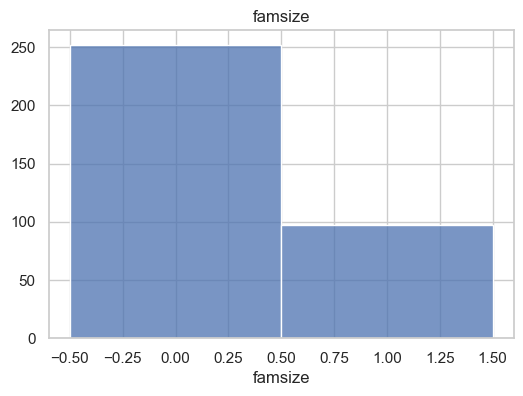

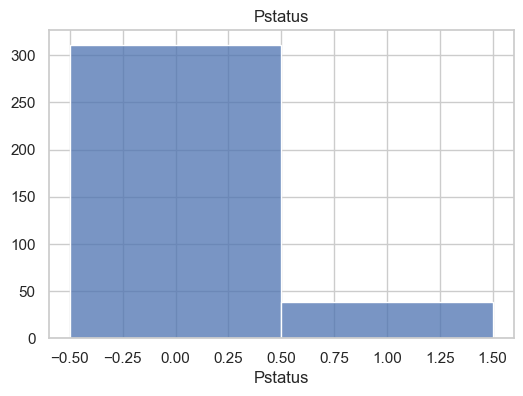

...

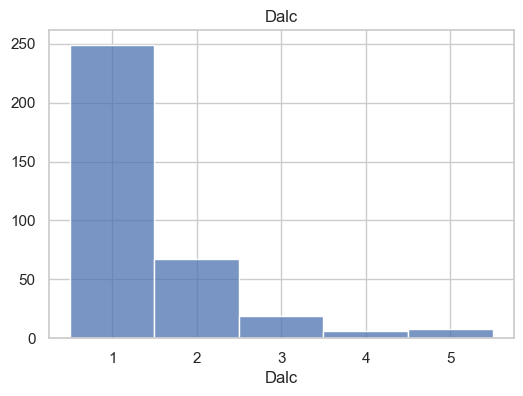

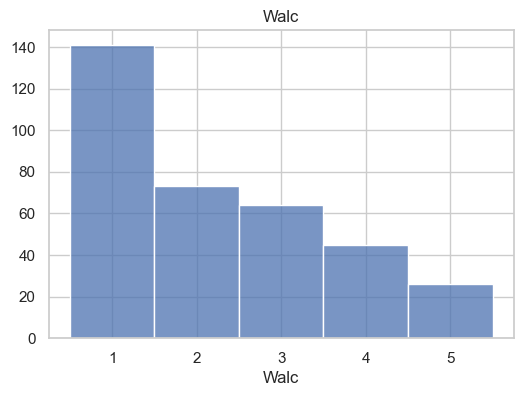

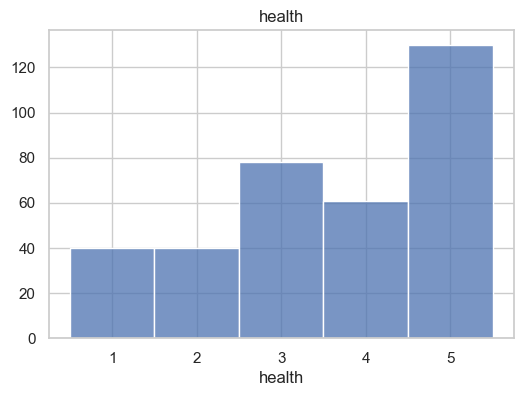

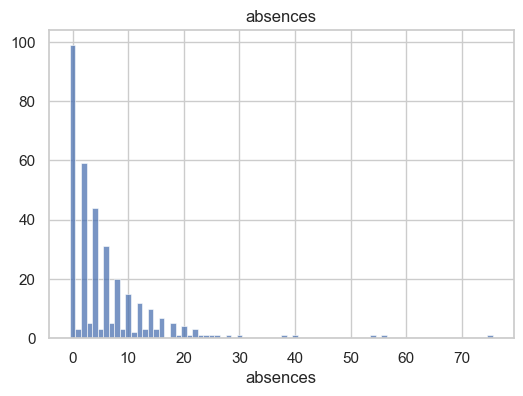

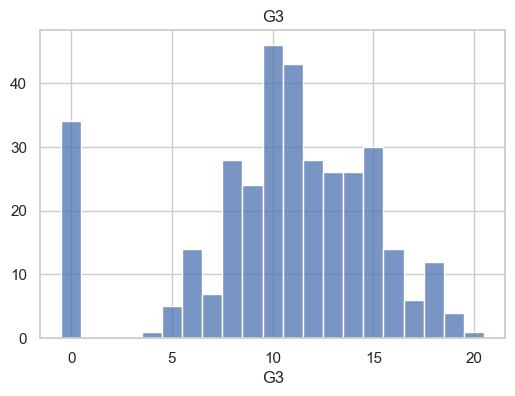

In [113]:
# histogram
path = 'histogram'
check_path(path)

for col in data.columns:
    plt.figure(figsize=(6, 4))
    sns.histplot(data[col], discrete=True, kde=False)
    plt.title(f"{col.replace('_', ' ')}")
    plt.xlabel(col)
    plt.ylabel('')
    plt.savefig(f'{path}\\{col}.png')
    plt.show()

In [ ]:
# kernel density
path = 'kernel density'
check_path(path)

for col in data_original.columns:
    plt.figure(figsize=(6, 4))
    sns.histplot(data_original[col], discrete=True, kde=True)
    plt.title(f"{col.replace('_', ' ')}")
    plt.xlabel(col)
    plt.ylabel('')
    plt.savefig(f'{path}\\{col}.png')
    plt.show()

In [ ]:
# remove the first one-hot encoding parameter to avoid collinearity
df = df.drop(columns=[f'{k}_{v[0]}' for k, v in one_hot_encoding.items()], errors='ignore')
print(f'dataset drop one-hot encoding:\n{df.head()}')

In [ ]:
# drop G1, G2
df.drop(columns=['G1', 'G2'], inplace=True)
print(f'df:\n{df}')

In [ ]:
# PCA
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

## data sotred
Y = df[Y_label].astype(float)
X = df.drop(columns=[Y_label]).astype(float)
print(f'Y: \n{Y}')
print(f'X: \n{X}')

## standardize
scaler = StandardScaler()
X_scaled = pd.DataFrame(scaler.fit_transform(X), columns = X.columns, index=X.index)
print(f'X_scaled:\n{X_scaled}')

## PCA
pca = PCA()
X_reduced = pd.DataFrame(pca.fit_transform(X_scaled), index = X.index)
pca_components_df = pd.DataFrame(
    pca.components_,
    columns = X.columns,
    index = [f"PC{i+1}" for i in range(pca.n_components_)]
)
pca_components_df["Explained Variance"] = pca.explained_variance_ratio_
pca_components_df["Cumulative Explained Variance"] = pca.explained_variance_ratio_.cumsum()
pca_components_df["Most Important Feature"] = pca_components_df.iloc[:, :-3].abs().idxmax(axis = 1)
print(f'PCA weighted:\n{pca_components_df}')

## variance plot
plt.figure(figsize = (16, 9))
plt.plot(np.arange(1, pca_components_df.shape[0] + 1), pca_components_df["Explained Variance"], color = "black", label = "Explained Variance")
plt.plot(np.arange(1, pca_components_df.shape[0] + 1), 1 - pca_components_df["Cumulative Explained Variance"], color = "blue", label = "Remaining Explained Variance")
plt.plot(np.arange(1, pca_components_df.shape[0] + 1), pca_components_df["Cumulative Explained Variance"], color = "red", label = "Cumulative Explained Variance")
plt.xlabel("Number of Components (Most Important Feature)")
plt.ylabel("Remind Cumulative Explained Variance")
plt.title("Remind Cumulative Explained Variance vs. Number of Components")
plt.xticks(
    ticks=np.arange(1, pca_components_df.shape[0] + 1),
    labels=[f"PC{i}\n({feat})" for i, feat in enumerate(pca_components_df['Most Important Feature'], start=1)],
    rotation=45,
    ha='right'
)

plt.legend(loc="upper right")
path = 'PCA'
check_path(path)
plt.savefig(f'{path}\\PCA_variance_plot.png')
plt.show()

## data after PCA
X_pca = pd.DataFrame()
for i in range(pca.components_.shape[0]):
    X_pca[f"PC{i+1}"] = X.values @ pca.components_[i]
print(f'X_pca:\n{X_pca}')

In [ ]:
pca_components_df['Most Important Feature']

In [ ]:
# scatter plot of PCA weighted with 20% variance
threshold = 0.2
choose_pc = int((pca_components_df["Cumulative Explained Variance"] >= threshold).idxmax().replace("PC", ""))

for i in range(choose_pc):
    for j in range(choose_pc):
        if i >= j:
            continue
        x = pca_components_df.index[i]
        y = pca_components_df.index[j]
        df_plot = pd.DataFrame({
            f'{x}': pca_components_df.iloc[i, :-3].values,
            f'{y}': pca_components_df.iloc[j, :-3].values,
            'Feature': pca_components_df.columns[:-3]
        })

        fig = px.scatter(
            df_plot,
            x=f'{x}',
            y=f'{y}',
            text='Feature',
            title=f'{x} vs {y}'
        )

        fig.add_shape(type='line', x0=0, x1=0, y0=df_plot[f'{y}'].min(), y1=df_plot[f'{y}'].max(),
                    line=dict(color='black', dash='dash'))
        fig.add_shape(type='line', y0=0, y1=0, x0=df_plot[f'{x}'].min(), x1=df_plot[f'{x}'].max(),
                    line=dict(color='black', dash='dash'))

        fig.update_traces(textposition='top right')

        fig.update_layout(
            xaxis_title=f'{x}',
            yaxis_title=f'{y}',
            width=800,
            height=800,
            showlegend=True
        )

        path = 'PCA\\scatter plot\\weighted'
        check_path(path)
        fig.write_html(f'{path}\\{pca_components_df.index[i]}_vs_{pca_components_df.index[j]}.html')

        fig.show()


In [ ]:
# scatter plot of PCA weighted with 20% variance
threshold = 0.2
choose_pc = int((pca_components_df["Cumulative Explained Variance"] >= threshold).idxmax().replace("PC", ""))

for i in range(choose_pc):
    for j in range(choose_pc):
        if i >= j:
            continue
        x = pca_components_df.iloc[i, :-3]
        y = pca_components_df.iloc[j, :-3]

        plt.figure(figsize=(10, 10))
        plt.scatter(x, y)

        for k, label in enumerate(pca_components_df.columns[:-3]):
            plt.text(x.iloc[k], y.iloc[k], label)

        plt.axhline(0, color='black', linestyle='--')
        plt.axvline(0, color='black', linestyle='--')

        plt.xlabel(f'{pca_components_df.index[i]}')
        plt.ylabel(f'{pca_components_df.index[j]}')
        plt.title(f'{pca_components_df.index[i]} vs {pca_components_df.index[j]}')
        plt.grid(True)
        path = 'PCA\\scatter plot\\weighted'
        check_path(path)
        plt.savefig(f'{path}\\{pca_components_df.index[i]}_vs_{pca_components_df.index[j]}.png')
        plt.show()

In [ ]:
# scatter plot 3d of PCA weighted with PC1, PC2, and PC3
fig = px.scatter_3d(
    pca_components_df.T,
    x='PC1',
    y='PC2',
    z='PC3',
    text=pca_components_df.T.index,
    labels={'x': 'PC1', 'y': 'PC2', 'z': 'PC3'},
    title='PC1 vs. PC2 vs. PC3 PCA weighted',
    width=800,
    height=800
)

fig.update_traces(
    marker=dict(
        size=3  # 點的大小
    ),
    textposition='top center',
    textfont=dict(
        color='rgba(0, 0, 0, 0.5)',  # 半透明文字
        size=10
    )
)

fig.update_layout(
    scene=dict(
        aspectmode='cube'
    )
)

path = f'PCA\\scatter plot\\weighted'
check_path(path)
fig.write_html(f'{path}\\PC1_PC2_PC3.html')
fig.show()

In [ ]:
# scatter plot of PCA vs G3 with 10% variance
threshold = 0.1
choose_pc = int((pca_components_df["Cumulative Explained Variance"] >= threshold).idxmax().replace("PC", ""))

for i in range(choose_pc):
    plt.figure(figsize=(10, 10))
    plt.scatter(X_pca.iloc[:, i], Y)
    plt.xlabel(f"PC{i+1}")
    plt.ylabel("G3")
    plt.title(f"PC{i+1} vs G3")
    plt.grid(True)
    path = 'PCA\\scatter plot\\PC_vs_Y'
    check_path(path)
    plt.savefig(f'{path}\\PC{i+1}_vs_G3.png')
    plt.show()

In [ ]:
# scatter plot of PCA transform data with 10% variance
threshold = 0.2
choose_pc = int((pca_components_df["Cumulative Explained Variance"] >= threshold).idxmax().replace("PC", ""))

for i in range(choose_pc):
    for j in range(choose_pc):
        if i >= j:
            continue
        x = X_pca.iloc[:, i]
        y = X_pca.iloc[:, j]

        plt.figure(figsize=(10, 10))
        plt.scatter(x, y)

        plt.xlabel(f'{X_pca.columns[i]}')
        plt.ylabel(f'{X_pca.columns[j]}')
        plt.title(f'{X_pca.columns[i]} vs {X_pca.columns[j]} transform data')
        plt.grid(True)

        path = 'PCA\\scatter plot\\transform_data'
        check_path(path)
        plt.savefig(f'{path}\\{X_pca.columns[i]}_vs_{X_pca.columns[j]}.png')
        plt.show()

- scikit-learn 偏向**機器學習**設計，強調預測與泛化能力。

- statsmodels 偏向**統計建模與推論**，更適合做學術或統計分析。

In [ ]:
# MLR by sklearn
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

lm = LinearRegression()
lm.fit(X_train, Y_train)

Y_pred = lm.predict(X_test)

r2 = r2_score(Y_test, Y_pred)
adjusted_r2 = 1 - (1 - r2) * (len(Y_test) - 1) / (len(Y_test) - X_test.shape[1] - 1)

print(f'Coefficients:\n{lm.coef_}')
print(f'Intercept:\n{lm.intercept_}')
print(f'Mean Squared Error:\n{mean_squared_error(Y_test, Y_pred)}')
print(f'R^2 Score:\n{r2}')
print(f'Adjusted R^2 Score:\n{adjusted_r2}')
print(f'Residuals (Y_pred - Y_test):\n{Y_pred - Y_test.values}')
coef_df = pd.DataFrame({
    'Feature': X.columns,
    'Coefficient': lm.coef_
})
print(f'\nModel Coefficient Summary:\n{coef_df}')

In [ ]:
# MLR by statsmodels
import statsmodels.api as sm

X = sm.add_constant(X)
lm = sm.OLS(Y, X).fit()
print(f'Summary:\n {lm.summary()}')

print(f'MSE:\n {lm.mse_model}')

In [ ]:

data_original = data_original.loc[(data_original['school'] == 'GP'), :]
data_original.drop(columns=['G1', 'G2', 'school'], inplace=True)
data_original.shape

In [ ]:
# MLR by statsmodels
X_original = data_original.copy()
Y_original = data_original[Y_label]
for k, v in factors.items():
    X_original[k + '_factor'] = pd.Categorical(X_original[k], categories=v, ordered=True).codes  ## assign the factor codes
for k, v in one_hot_encoding.items():
    if k in X_original.columns:
        X_original = pd.get_dummies(X_original, columns=[k] , prefix=k)
X_original = X_original.drop(columns=[k for k, v in factors.items()])
X_original = X_original.rename(columns=dict((k + '_factor', k) for k, v in factors.items()), errors='ignore')
X_original = X_original.drop(columns=[f'{k}_{v[0]}' for k, v in one_hot_encoding.items()], errors='ignore')
X_original = X_original.drop(columns=[Y_label]).astype(float)

X_original = sm.add_constant(X_original)
lm_original = sm.OLS(Y_original, X_original).fit()
print(f'Summary:\n {lm_original.summary()}')

print(f'MSE:\n {lm_original.mse_model}')

In [ ]:
# MLR with PCA by statsmodels

X_pca = sm.add_constant(X_pca)
lm_pca = sm.OLS(Y, X_pca).fit()
print(f'Summary:\n {lm_pca.summary()}')

print(f'MSE:\n {lm_pca.mse_model}')

In [ ]:
# MLR with PCA with 80% variance by statsmodels
threshold = 0.8
choose_pc = int((pca_components_df["Cumulative Explained Variance"] >= threshold).idxmax().replace("PC", ""))
print(f'Choose {choose_pc} PCs to explain {threshold * 100}% of variance.')

X_pca_80 = X_pca.iloc[:, :(choose_pc+1)]  # 80% of variance
X_pca_80 = sm.add_constant(X_pca_80)
lm_pca_80 = sm.OLS(Y, X_pca_80).fit()
print(f'Summary:\n {lm_pca_80.summary()}')

print(f'MSE:\n {lm_pca_80.mse_model}')


In [ ]:
# 3 models comparison
MLR_comparison = pd.DataFrame(
    {'R^2': [lm.rsquared, lm_pca.rsquared, lm_pca_80.rsquared],
     'Adj. R^2': [lm.rsquared_adj, lm_pca.rsquared_adj, lm_pca_80.rsquared_adj],
     'MSE':[lm.mse_model, lm_pca.mse_model,lm_pca_80.mse_model],
     'F-statistic':[lm.f_pvalue, lm_pca.f_pvalue,lm_pca_80.f_pvalue]
     },
    
    index=['lm', 'lm_pca', 'lm_pca_80']
)

print(f'models comparison:\n{MLR_comparison}')

In [ ]:
# functions for significant variables in MLR (P > |t| < alpha: model)
def significant_variables(model, alpha: float, model_name: str):
    sig_value = model.pvalues
    sig = []
    
    for var, pval in sig_value.items():
        if pval < alpha:
            sig.append((var, round(pval, 4)))
    
    for var, p in sig:
        print(f'significant variables in {model_name}:\n{var}: {p}')

significant_variables(lm_original, 0.05, 'MLR for original data')
significant_variables(lm, 0.05, 'MLR')
significant_variables(lm_pca, 0.05, 'MLR with PCA')
significant_variables(lm_pca_80, 0.05, 'MLR with PCA with 80% variance')

In [ ]:
# functions for model diagnostics and qqplot with MLR
path = 'MLR'
check_path(path)
def model_diagnostics(x, y, model, title='MLR'):
    resdidual = model.predict(x) - y
    plt.figure(figsize=(10, 6))
    sm.qqplot(resdidual, line='s')
    plt.title(f'QQ-plot of residuals for {title}')
    plt.savefig(f'{path}\\qqplot_{title}.png')
    plt.show()
    print(f'residual:\n', resdidual)

# qqplot
model_diagnostics(X_original, Y_original, lm_original, 'MLR for original data')
model_diagnostics(X, Y, lm, 'MLR')
model_diagnostics(X_pca, Y, lm_pca, 'MLR with PCA')
model_diagnostics(X_pca_80, Y, lm_pca_80, 'MLR with PCA 80% variance')

# qqplot for each MLR
models = [
    (X_original,  Y_original, lm_original,    'Original Data'),
    (X_pca_80,    Y,          lm_pca_80,      'PCA 80% Var'),
    (X,           Y,          lm,             'MLR'),
    (X_pca,       Y,          lm_pca,         'PCA')
]

fig, axes = plt.subplots(2, 2, figsize=(16, 12))
for ax, (x, y, model, title) in zip(axes.flatten(), models):
    residuals = model.predict(x) - y
    sm.qqplot(residuals, line='s', ax=ax)
    ax.set_title(f'QQ-plot of residuals: {title}', fontsize=20)
    ax.tick_params(axis='both', labelsize=15)
    ax.set_xlabel(ax.get_xlabel(), fontsize=15)
    ax.set_ylabel(ax.get_ylabel(), fontsize=15)

plt.tight_layout()
fig.savefig(f'{path}\\qqplot_2x2.png', dpi=300)
plt.show()


In [115]:
#Stepwise variables selection by SWL
import statsmodels.api as sm

def bidirectional_elimination(X, y, p_threshold=0.05):
    selected_feature = []
    remaining_feature = list(X.columns)
    best_aic = float('inf')
    
    while remaining_feature or selected_feature:
        improved = False
        
        # Forward Step
        forward_candidates = []
        for f in remaining_feature:
            model = sm.OLS(y, sm.add_constant(X[selected_feature + [f]])).fit()
            forward_candidates.append((model.aic, f))
        
        forward_candidates.sort()
        best_forward_aic, best_candidate = forward_candidates[0]
        
        if best_forward_aic < best_aic:
            best_aic = best_forward_aic
            selected_feature.append(best_candidate)
            remaining_feature.remove(best_candidate)
            improved = True
        
        # Backward Step
        model = sm.OLS(y, sm.add_constant(X[selected_feature])).fit()
        p_values = model.pvalues.iloc[1:]  # ignore intercept
        max_p_value = p_values.max()
        
        if max_p_value > p_threshold:
            worst_feature = p_values.idxmax()
            selected_feature.remove(worst_feature)
            remaining_feature.append(worst_feature)
            improved = True
        
        if not improved:
            break
            
    return selected_feature



best_features_original, best_features_x, best_features_pca, best_features_pca_80 = [], [], [], []
models = [
    (X_original,  Y_original, lm_original,    'Original Data', best_features_original),
    (X_pca_80,    Y,          lm_pca_80,      'PCA 80% Var', best_features_pca_80),
    (X,           Y,          lm,             'MLR', best_features_x),
    (X_pca,       Y,          lm_pca,         'PCA', best_features_pca)
]

for x, y, mdl, title, save in models:
    best_features = bidirectional_elimination(x, y)
    save[:] = best_features.copy()
    print(f"Selected feature of {title}:", best_features)



NameError: name 'X_original' is not defined

In [114]:
#Stepwis Selected feature to PCA
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import statsmodels.api as sm

selected = bidirectional_elimination(X, Y_original, p_threshold=0.05)
print("Selected feature of Original Data (Reduce) :", selected)

SW_sel = X[selected].astype(float)

scaler = StandardScaler()
SW_scaled = scaler.fit_transform(SW_sel)

pca = PCA().fit(SW_scaled)

SW_pca = pca.transform(SW_scaled)
SW_pca_df = pd.DataFrame(
    SW_pca,
    index = SW_sel.index,
    columns = [f"PC{i+1}" for i in range(SW_pca.shape[1])]
    
)

pca_info = pd.DataFrame(
    pca.components_,
    columns = selected,
    index = SW_pca_df.columns
)
pca_info["Explained Variance"]            = pca.explained_variance_ratio_
pca_info["Cumulative Explained Variance"] = pca.explained_variance_ratio_.cumsum()
pca_info["Most Important Feature"] = (
    pca_info[selected]
    .abs()
    .idxmax(axis=1)
)


print(pca_info)

explained = pca_info["Explained Variance"].values
cum_var    = pca_info["Cumulative Explained Variance"].values
remaining  = 1 - cum_var

n = len(selected)
x = np.arange(1, n+1)
xticks = [
    f"PC{i}\n({feat})"
    for i, feat in enumerate(pca_info["Most Important Feature"], start=1)
]

plt.figure(figsize=(16, 9))
plt.plot(x, explained, color="black", marker="o", label="Explained Variance")
plt.plot(x, remaining, color="blue",  marker="s", label="Remaining Explained Variance")
plt.plot(x, cum_var,    color="red",   marker="^", label="Cumulative Explained Variance")

plt.xticks(x, xticks, rotation=45, ha="right")
plt.xlabel("Number of Components (Most Important Feature)")
plt.ylabel("Variance Ratio")
plt.title("Remind Cumulative Explained Variance vs. Number of Components")
plt.grid(True, linestyle="--", linewidth=0.5)
plt.legend(loc="upper right")
plt.tight_layout()
path = 'PCA'
check_path(path)
plt.savefig(f'{path}\\SW_PCA_plot.png')
plt.show()

SW_pc_reg = sm.add_constant(SW_pca_df)        
model_sw_PCA = sm.OLS(Y_original, SW_pc_reg).fit()

print(model_sw_PCA.summary())

print(f"R^2:           {model_sw_PCA.rsquared:.4f}")
print(f"Adj. R^2:      {model_sw_PCA.rsquared_adj:.4f}")
print(f"MSE:           {model_sw_PCA.mse_resid:.4f}")
print(f"F-statistic:   {model_sw_PCA.fvalue:.4f}")
print(f"P-value (F):   {model_sw_PCA.f_pvalue:.4e}")


NameError: name 'bidirectional_elimination' is not defined

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches 

def make_color_array(G3_array):
    G3_vals = np.array(G3_array)  
    colors = np.full(shape=G3_vals.shape, fill_value='white', dtype=object)

    mask_blue = (G3_vals >= 0) & (G3_vals <= 5)
    colors[mask_blue] = 'blue'

    mask_red = (G3_vals >= 15) & (G3_vals <= 20)
    colors[mask_red] = 'red'
    
    return colors


colors_pca   = make_color_array(Y)           
colors_swpca = make_color_array(Y_original) 

fig, axes = plt.subplots(1, 2, figsize=(16, 6), sharey=False)

axes[0].scatter(
    X_pca['PC1'], X_pca['PC2'],
    c=colors_pca, 
    edgecolor='k',
    s=50
)
axes[0].set_title('PCA: PC1 vs PC2')
axes[0].set_xlabel('PC1')
axes[0].set_ylabel('PC2')
axes[0].grid(linestyle='--', linewidth=0.5)

axes[1].scatter(
    SW_pca_df['PC1'], SW_pca_df['PC2'],
    c=colors_swpca,  
    edgecolor='k',
    s=50
)
axes[1].set_title('SW PCA: PC1 vs PC2')
axes[1].set_xlabel('PC1')
axes[1].grid(linestyle='--', linewidth=0.5)


patch_blue  = mpatches.Patch(color='blue',  label='G3  [0, 5]')
patch_white = mpatches.Patch(color='white', label='G3  [6, 14]')
patch_red   = mpatches.Patch(color='red',   label='G3  [15, 20]')


axes[1].legend(
    handles=[patch_blue, patch_white, patch_red],
    loc='upper right',
    frameon=True
)

plt.tight_layout()
path = 'PCA'
check_path(path)
plt.savefig(f'{path}\\PC1_PC2_withG3.png')
plt.show()


In [ ]:
def bidirectional_elimination(X, y, p_threshold=0.05):
    selected_feature = []
    remaining_feature = list(X.columns)
    best_aic = float('inf')
    
    while remaining_feature or selected_feature:
        improved = False
        
        # Forward Step
        forward_candidates = []
        for f in remaining_feature:
            model = sm.OLS(y, sm.add_constant(X[selected_feature + [f]])).fit()
            forward_candidates.append((model.aic, f))
        
        forward_candidates.sort()
        best_forward_aic, best_candidate = forward_candidates[0]
        
        if best_forward_aic < best_aic:
            best_aic = best_forward_aic
            selected_feature.append(best_candidate)
            remaining_feature.remove(best_candidate)
            improved = True
        
        # Backward Step
        model = sm.OLS(y, sm.add_constant(X[selected_feature])).fit()
        p_values = model.pvalues.iloc[1:]  # ignore intercept
        max_p_value = p_values.max()
        
        if max_p_value > p_threshold:
            worst_feature = p_values.idxmax()
            selected_feature.remove(worst_feature)
            remaining_feature.append(worst_feature)
            improved = True
        
        if not improved:
            break
            
    return selected_feature

# Store best features
best_features_original, best_features_x, best_features_pca, best_features_pca_80 = [], [], [], []
models = [
    (X_original,  Y_original, 'Original Data', best_features_original),
    (X_pca_80,    Y,          'PCA 80% Var',    best_features_pca_80),
    (X,           Y,          'MLR',            best_features_x),
    (X_pca,       Y,          'PCA',            best_features_pca)
]

model_name = {}

for x, y, title, save in models:
    best_features = bidirectional_elimination(x, y)
    save[:] = best_features.copy()
    print(f"Selected features for {title}:", best_features)

# Stepwise diagnostics and QQ-plot
def stepwise_model_diag(Y, best_features, title, dataset):
    x_feature = dataset[best_features]
    x_feature = sm.add_constant(x_feature)
    model = sm.OLS(Y, x_feature).fit()
    model_name[title] = model
    print(f'\nSummary of {title}:\n{model.summary()}')
    return model.resid, model

fig, axes = plt.subplots(2, 2, figsize=(16, 12))
model_defs = [
    (Y_original, best_features_original, 'Original Data', X_original),
    (Y,          best_features_pca_80,   'PCA 80% Var',   X_pca_80),
    (Y,          best_features_x,        'MLR',           X),
    (Y,          best_features_pca,      'PCA',           X_pca)
]

for ax, (y, features, title, dataset) in zip(axes.flatten(), model_defs):
    residuals, _ = stepwise_model_diag(y, features, title, dataset)
    sm.qqplot(residuals, line='s', ax=ax)
    ax.set_title(f'QQ-plot of residuals: {title}', fontsize=16)
    ax.tick_params(axis='both', labelsize=12)

plt.tight_layout()
path = 'MLR'
check_path(path)
fig.savefig(f'{path}\\qqplot_2x2_sw.png', dpi=300)
plt.show()

In [ ]:
model_metrics = []

models = [lm_original, lm, lm_pca, lm_pca_80, model_name['Original Data'], model_name['PCA 80% Var'], model_name['MLR'], model_name['PCA']]
# Model names for identification
model_names = ['Original', 'lm', 'PCA All', 'PCA 80%', 'Original Data', 'PCA 80% Var', 'MLR', 'PCA']

# Loop through models and store metrics
for name, model in zip(model_names, models):
    metrics_dict = {
        'Model': name,
        'R^2': model.rsquared,
        'Adj. R^2': model.rsquared_adj,
        'MSE': model.mse_model,
        'F-statistic': model.f_pvalue,
        'P-value': model.pvalues.max()
    }
    model_metrics.append(metrics_dict)

# Convert the list of dictionaries to a DataFrame
model_compare_df = pd.DataFrame(model_metrics)

model_compare_df

In [ ]:

parent = data_original[['Medu','Fedu','Mjob','Fjob']]
combo_cols = parent.columns.tolist()

combo_counts = (parent.groupby(combo_cols).size().reset_index(name='count'))
combo_counts['proportion'] = combo_counts['count'] / combo_counts['count'].sum()
combo_counts = combo_counts.sort_values(by='count', ascending=False)

y_labels = combo_counts.apply(lambda row: ' | '.join(f"{col}={row[col]}" for col in combo_cols), axis=1)

top_n = 10
combo_counts_top = combo_counts.head(top_n)
labels = y_labels.head(top_n).tolist()
counts = combo_counts_top['count'].values

plt.figure(figsize=(16, 12))

y_pos = np.arange(top_n)

colors = plt.cm.coolwarm(np.linspace(0, 1, top_n))
plt.barh(y_pos, counts, color=colors, height=0.7)

plt.gca().invert_yaxis()

plt.yticks([])

max_count = counts.max()
plt.xlim(0, max_count * 1.1)

for i, (cnt, lbl) in enumerate(zip(counts, labels)):
    plt.text(
        x=max_count * 0.01,
        y=i,
        s=lbl,
        va='center', ha='left',
        color='black', fontsize=14
    )
    plt.text(
        x=cnt + max_count * 0.01,
        y=i,
        s=str(cnt),
        va='center', ha='left',
        color='black', fontsize=14
    )


plt.xlabel('Occurrence')
plt.title('Visualisation of Parents jobs and their education')
plt.tight_layout()

path = 'bar plot'
check_path(path)
plt.savefig(f'{path}\\Visualisation of Parents jobs and their education.png')
plt.show()

In [ ]:
# Average G3 by parent
data_original['combo'] = data_original[combo_cols] \
    .apply(lambda r: ' | '.join(f"{c}={r[c]}" for c in combo_cols), axis=1)

top_labels = y_labels.head(top_n).tolist()
df10 = data_original[data_original['combo'].isin(top_labels)]

avg_g3 = df10.groupby('combo', as_index=False)['G3'].mean()

plt.figure(figsize=(16, 12))
ax = sns.barplot(
    data=avg_g3,
    y='combo',
    x='G3',
    order=top_labels,
    palette='coolwarm'
)

ax.set_yticks([])
ax.set_ylabel('')

max_val = avg_g3['G3'].max()
ax.set_xlim(0, max_val * 1.1)

for patch, lbl, val in zip(ax.patches, top_labels, avg_g3['G3']):
    x0 = patch.get_width()
    y0 = patch.get_y() + patch.get_height() / 2

    ax.text(
        x=max_val * 0.01,    
        y=y0,
        s=lbl,
        va='center', ha='left',
        color='black',
        fontsize=14
    )

    ax.text(
        x=x0 + max_val * 0.01,
        y=y0,
        s=f"{val:.2f}",
        va='center', ha='left',
        color='black',
        fontsize=14
    )

ax.set_xlabel('Average G3')
ax.set_title('Average G3 by Parent Combo')
plt.tight_layout()

path = 'bar plot'
check_path(path)
plt.savefig(f'{path}\\Average G3 by Parent.png', dpi=300)
plt.show()

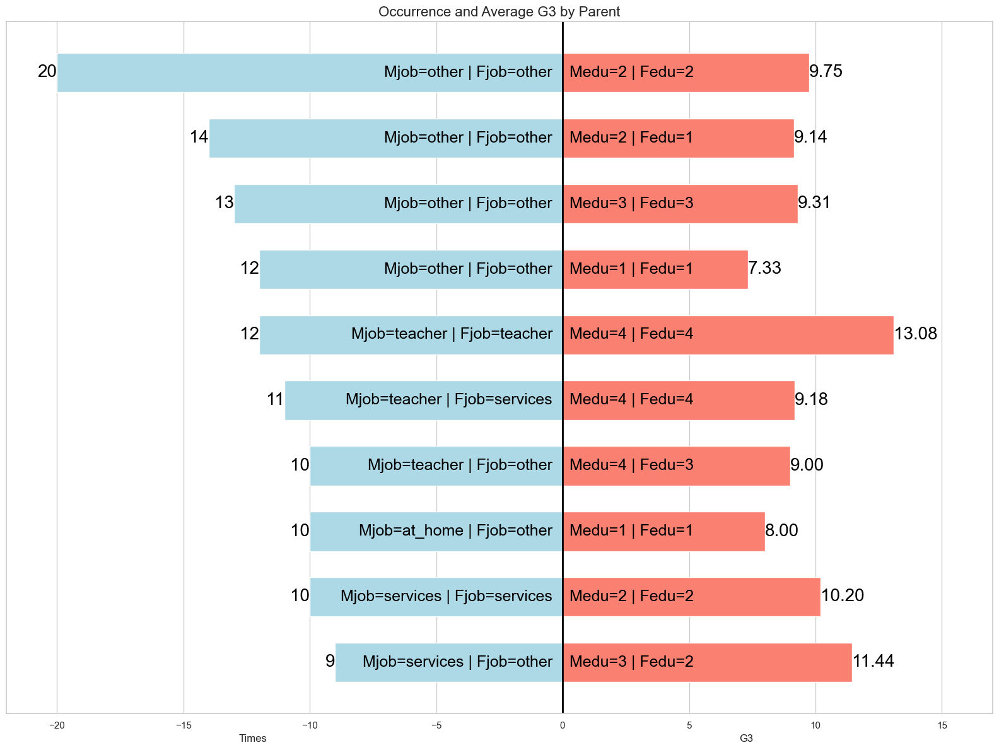

In [88]:
parent = data_original[['Medu','Fedu','Mjob','Fjob']]
combo_cols = parent.columns.tolist()
combo_counts = (
    parent
    .groupby(combo_cols)
    .size()
    .reset_index(name='count')
)
combo_counts['proportion'] = combo_counts['count'] / combo_counts['count'].sum()
combo_counts = combo_counts.sort_values(by='count', ascending=False)

y_labels = combo_counts.apply(
    lambda row: ' | '.join(f"{col}={row[col]}" for col in combo_cols),
    axis=1
)

top_n = 10
combo_counts_top = combo_counts.head(top_n)
labels = y_labels.head(top_n).tolist()
counts = combo_counts_top['count'].values

data_original['combo'] = data_original[combo_cols] \
    .apply(lambda r: ' | '.join(f"{c}={r[c]}" for c in combo_cols), axis=1)
df10 = data_original[data_original['combo'].isin(labels)]
avg_df = df10.groupby('combo', as_index=False)['G3'].mean()
avg_vals = avg_df.set_index('combo').loc[labels, 'G3'].values

left_labels = combo_counts_top.apply(
    lambda row: f"Medu={row['Medu']} | Fedu={row['Fedu']}",
    axis=1
).tolist()
right_labels = combo_counts_top.apply(
    lambda row: f"Mjob={row['Mjob']} | Fjob={row['Fjob']}",
    axis=1
).tolist()

y_pos = np.arange(top_n)
bar_h = 0.6

plt.figure(figsize=(16, 12))

plt.barh(y_pos,
         -counts,
         height=bar_h,
         color='lightblue',
         label='Occurrence')

plt.barh(y_pos,
         avg_vals,
         height=bar_h,
         color='salmon',
         label='Average G3')

plt.gca().invert_yaxis()
plt.yticks([])

max_cnt = counts.max()
max_avg = avg_vals.max()
plt.xlim(-max_cnt * 1.1, max_avg * 1.3)
plt.axvline(0, color='black', linewidth=2) 

for i, (cnt, avg) in enumerate(zip(counts, avg_vals)):

    plt.text(
        x=-max_cnt * 0.02,
        y=i,
        s=right_labels[i],
        va='center', ha='right',
        color='black', fontsize=18
    )

    plt.text(
        x=-cnt,
        y=i,
        s=str(cnt),
        va='center', ha='right',
        color='black', fontsize=20
    )

    plt.text(
        x=max_avg * 0.02,
        y=i,
        s=left_labels[i],
        va='center', ha='left',
        color='black', fontsize=18
    )

    plt.text(
        x=avg,
        y=i,
        s=f"{avg:.2f}",
        va='center', ha='left',
        color='black', fontsize=20
    )


plt.title('Occurrence and Average G3 by Parent', fontsize=16)
ax = plt.gca()
ax.text(
    0.25,       
    -0.03,      
    'Times',
    transform=ax.transAxes,
    ha='center', va='top',
    fontsize=12
)

ax.text(
    0.75,       
    -0.03,      
    'G3',
    transform=ax.transAxes,
    ha='center', va='top',
    fontsize=12
)

plt.tight_layout()
path = 'bar plot'
check_path(path)
plt.savefig(f'{path}\\Occurrence and AvgG3 combined.png')
plt.show()

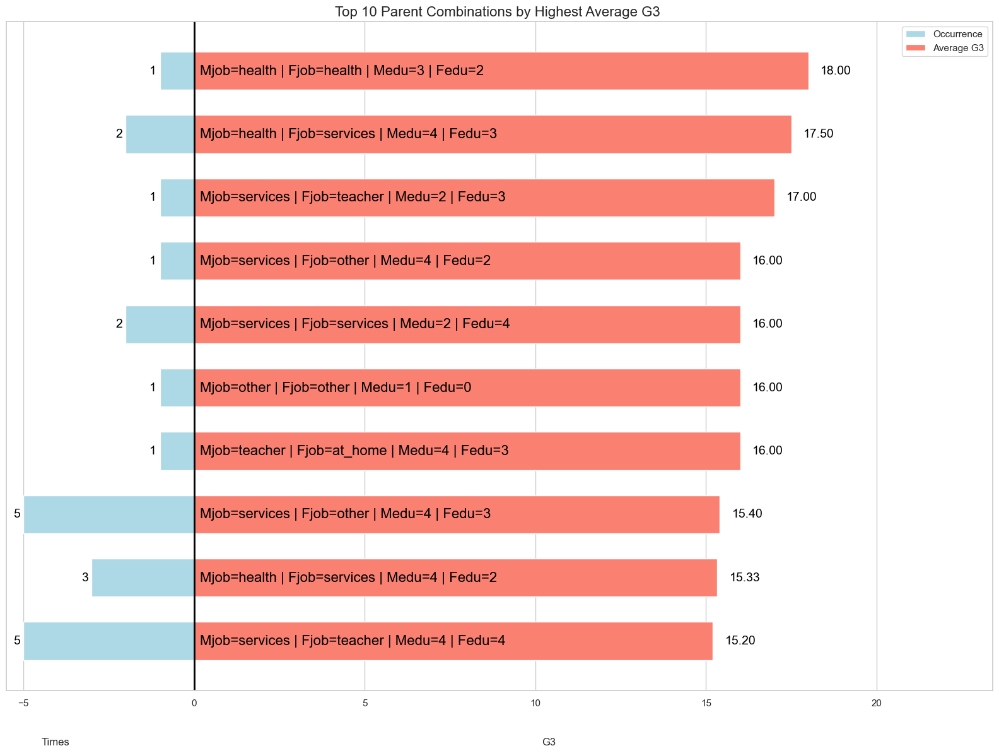

In [100]:
top_n = 10

combo_cols = ['Medu', 'Fedu', 'Mjob', 'Fjob']
group_df = (
    data_original
    .groupby(combo_cols)
    .agg(count=('G3', 'size'), avg=('G3', 'mean'))
    .reset_index()
)

group_df['combo'] = group_df.apply(
    lambda r: f"Mjob={r['Mjob']} | Fjob={r['Fjob']} | Medu={r['Medu']} | Fedu={r['Fedu']}",
    axis=1
)

top_df = group_df.sort_values(by='avg', ascending=False).head(top_n).copy()

counts = top_df['count'].values        
avgs   = top_df['avg'].values          
labels = top_df['combo'].tolist()      

y_pos = np.arange(top_n)
bar_h = 0.6

plt.figure(figsize=(16, 12))

plt.barh(y_pos, -counts, height=bar_h, color='lightblue', label='Occurrence')

plt.barh(y_pos, avgs, height=bar_h, color='salmon', label='Average G3')

plt.gca().invert_yaxis()

plt.yticks([])

max_cnt = counts.max()
max_avg = avgs.max()
plt.xlim(-max_cnt * 1.1, max_avg * 1.3)

plt.axvline(0, color='black', linewidth=2)

for i, (cnt, avg, label) in enumerate(zip(counts, avgs, labels)):
    plt.text(
        x = -cnt - max_cnt * 0.02,   
        y = i,
        s = str(cnt),
        va = 'center', ha = 'right',
        color = 'black', fontsize = 14
    )

    plt.text(
        x = avg + max_avg * 0.02,    
        y = i,
        s = f"{avg:.2f}",
        va = 'center', ha = 'left',
        color = 'black', fontsize = 14
    )

    plt.text(
        x = 0 + max_avg * 0.01,
        y = i,
        s = label,
        va = 'center', ha = 'left',
        color = 'black', fontsize = 16
    )

plt.title('Top 10 Parent Combinations by Highest Average G3 ', fontsize=16)
plt.legend(loc='upper right')

ax = plt.gca()
ax.text(0.05, -0.07, 'Times', transform=ax.transAxes, ha='center', va='top', fontsize=12)
ax.text(0.55, -0.07, 'G3', transform=ax.transAxes, ha='center', va='top', fontsize=12)
plt.tight_layout()
path = 'bar plot'
check_path(path)
plt.savefig(f'{path}\\top10 avgG3 combination.png')
plt.show()

In [ ]:
# MDS
from sklearn.manifold import MDS

Y = df['G3'].astype(float)
X = df.drop(columns=['G3']).astype(float)

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Apply MDS
n_components = 2
mds = MDS(n_components=n_components, random_state=42)
X_mds = mds.fit_transform(X_scaled)

# Plot the result
plt.figure(figsize=(12, 8))
scatter = plt.scatter(X_mds[:, 0], X_mds[:, 1], c=Y, cmap='jet', edgecolor='k', s=50)
plt.title("MDS Visualisation of G3 and Other Variables")
plt.xlabel("MDS Dimension 1")
plt.ylabel("MDS Dimension 2")
cbar = plt.colorbar(scatter)
cbar.set_label('G3 Score')
plt.grid(True)

path = 'MDS'
check_path(path)
plt.savefig(f'{path}\\MDS Visualisation of G3 and Other Variables.png')
plt.show()


In [ ]:
df.info()

In [ ]:
x_p = X_original[['absences','schoolsup','higher','failures','Mjob_at_home','Mjob_health','Mjob_services','Mjob_teacher']]
y_p = Y_original
x_p = sm.add_constant(x_p)
lm_select = sm.OLS(y_p,x_p).fit()
print(f'Summary:\n {lm_select.summary()}')

print(f'MSE:\n {lm_select.mse_model}')

In [ ]:
SW_pc_reg      = sm.add_constant(SW_pca_df)
model_sw_PCA  = sm.OLS(Y_original, SW_pc_reg).fit()

models.append(model_sw_PCA)
model_names.append('SW PCA')

model_metrics = []

models = [lm_original, lm, lm_pca, lm_pca_80, model_name['Original Data'], 
          #model_name['MLR'],  model_name['PCA'], model_name['PCA 80% Var'], 
          model_sw_PCA, lm_select]
# Model names for identification
model_names = ['Original', 'MLR', 'PCA All', 'PCA 80%', 'Original(Reduce)', 
               #'MLR(Reduce)', 'PCA(Reduce)', 'PCA 80% Var(Reduce)', 
               'SW PCA', 'Paper Proposed']

# Loop through models and store metrics
for name, model in zip(model_names, models):
    metrics_dict = {
        'Model': name,
        'R^2': model.rsquared,
        'Adj. R^2': model.rsquared_adj,
        'MSE': model.mse_model,
        'F-statistic': model.f_pvalue,
        'P-value': model.pvalues.max(),
        'A.I.C': model.aic
    }
    model_metrics.append(metrics_dict)

# Convert the list of dictionaries to a DataFrame
model_compare_df = pd.DataFrame(model_metrics)

model_compare_df

In [ ]:
#3 Most Important Feature with front table
model_metrics = []

models = [lm_original, lm, lm_pca, lm_pca_80, model_name['Original Data'], 
          #model_name['MLR'],  model_name['PCA'], model_name['PCA 80% Var'], 
          model_sw_PCA, lm_select]

model_names = ['Original', 'MLR', 'PCA All', 'PCA 80%', 'Original(Reduce)', 
               #'MLR(Reduce)', 'PCA(Reduce)', 'PCA 80% Var(Reduce)', 
               'SW PCA', 'Paper Proposed']

top3_list = []
for name, model in zip(model_names, models):
    df = pd.DataFrame({'Variable': model.params.index, 'Coefficient': model.params.values, 'P-value': model.pvalues.values})
    df['AbsCoef'] = df['Coefficient'].abs()

    df = df[df['Variable'] != 'const']

    df_sorted = df.sort_values('AbsCoef', ascending=False)   #P-value <0.05 use  df[df['P-value'] < 0.05].sort_values('AbsCoef', ascending=False) 

    top_vars = list(df_sorted['Variable'].iloc[:3])
    top_vars += [None] * (3 - len(top_vars))
    
    top3_list.append({'Model': name, 'Top1':  top_vars[0], 'Top2':  top_vars[1], 'Top3':  top_vars[2]})

top3_df = pd.DataFrame(top3_list)
print(top3_df)


In [ ]:
# spend time
end_time = time()
print(f'Time spent: {end_time - start_time} seconds')